# Performing landscape level predictions

Mount drive, install package


In [1]:
!pip install rasterio

In [2]:
import rasterio
###
site_path = "large_files/"

img_path = site_path + "S3.tif"
#img_path = site_path + "rgb/2016/Paracou_RGB_2016_10cm.tif"
tiles_path = site_path + "tilestest/"
#model_path = "/content/drive/Shareddrives/detectree2/models/220629_ParacouSepilokDanum_JB.pth"

# Read in the tiff file
data = rasterio.open(img_path)

RasterioIOError: large_files/S3.tif: No such file or directory

## Tiling
Tile up the entire orthomosaic to make predictions

  Cloning https://github.com/PatBall1/detectree2.git to c:\users\dell\appdata\local\temp\pip-req-build-jg96f247
  Resolved https://github.com/PatBall1/detectree2.git to commit e640838223bbb136c9475b01eef9162659ba19a5
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Cloning https://github.com/facebookresearch/detectron2.git to c:\users\dell\appdata\local\temp\pip-install-ndi714qf\detectron2_4111239d08164763b9f6c504059486ed
  Resolved https://github.com/facebookresearch/detectron2.git to commit d38d7161247e64276d4c44d9d0605291e80bd969
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'


  Running command git clone --filter=blob:none --quiet https://github.com/PatBall1/detectree2.git 'C:\Users\DELL\AppData\Local\Temp\pip-req-build-jg96f247'
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git 'C:\Users\DELL\AppData\Local\Temp\pip-install-ndi714qf\detectron2_4111239d08164763b9f6c504059486ed'
ERROR: Could not install packages due to an OSError: HTTPSConnectionPool(host='files.pythonhosted.org', port=443): Max retries exceeded with url: /packages/88/e8/f77e577b6d99ddf1fd69dfc6233b9deea0f94445bc979ef56652681caed1/gdal-3.11.3.tar.gz (Caused by SSLError(CertificateError("hostname 'files.pythonhosted.org' doesn't match 'r.shared-319-default.ssl.fastly.net'")))



In [3]:
from detectree2.preprocessing.tiling import tile_data
buffer = 35
tile_width = 40
tile_height = 40
tile_data(img_path, tiles_path, buffer, tile_width, tile_height, dtype_bool = True)

ModuleNotFoundError: No module named 'detectree2'

## Create full site predictions

### Access pre-trained model

Download pre-trained model

There might be a cleaner way to do it with `pkg_resources` but I haven't figured this out yet

In [4]:
import sys
print(sys.executable)

/Users/hbot07/anaconda3/bin/python


In [11]:
import detectron2
print(detectron2.__file__)

d:\gaurav\detectron2\detectron2\__init__.py


In [2]:
pip show detectron2

Note: you may need to restart the kernel to use updated packages.


In [1]:
import numpy
import cv2
print(numpy.__version__)  # should be 1.26.4
print(cv2.__version__)    # should be 4.7.0



1.26.4
4.7.0


In [12]:
from detectree2.models.train import MyTrainer, setup_cfg

# pretrained model?
#trained_model = "/content/drive/Shareddrives/detectree2/models/220629_ParacouSepilokDanum_JB.pth"
#trained_model = "/content/drive/Shareddrives/detectree2/models/220723_withParacouUAV.pth"
#trained_model = "/content/drive/Shareddrives/detectree2/models/230103_resize_full/model_4.pth"
# trained_model = "large_files/230103_randresize_full.pth"
trained_model = "large_files/urban_trees_Cambridge_20230630.pth"

cfg = setup_cfg(update_model=trained_model) # update_model arg can be used to load in trained  model

Make predictions!

In [13]:
# from detectree2.models.predict import predict_on_data
# from detectron2.engine import DefaultPredictor
# #cfg.MODEL.DEVICE='cpu'
# predict_on_data(directory=tiles_path, predictor=DefaultPredictor(cfg))
from detectree2.models.predict import predict_on_data
from detectron2.engine import DefaultPredictor
cfg.MODEL.DEVICE='cuda'
predict_on_data(directory=tiles_path, predictor=DefaultPredictor(cfg))


INFO:detectron2.checkpoint.detection_checkpoint:[DetectionCheckpointer] Loading from large_files/urban_trees_Cambridge_20230630.pth ...
INFO:fvcore.common.checkpoint:[Checkpointer] Loading from large_files/urban_trees_Cambridge_20230630.pth ...
c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\fvcore\common\checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We 

Predicting 9 files in mode rgb


c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\torch\functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3596.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Here we reproject predictions into geographical space

In [14]:
# from detectree2.models.outputs import project_to_geojson
# project_to_geojson(tiles_path, tiles_path + "predictions/", tiles_path + "predictions_geo/")
from detectree2.models.outputs import project_to_geojson
project_to_geojson(tiles_path, tiles_path + "predictions/", tiles_path + "predictions_geo/")

Projecting 9 files


Combine predictions into full output

In [15]:
import warnings
warnings.filterwarnings('ignore')

In [16]:
from detectree2.models.outputs import stitch_crowns, clean_crowns
#name = "Paracou"
folder = tiles_path+ "/predictions_geo"
crowns9 = stitch_crowns(folder, 1)

Remove invalid geometries before cleaning. Might be a way to fix them rather than remove all together but I think the ones with invalid geometries tend to be bad crowns anyway.

In [17]:
#crowns = stitch_crowns(folder, 1)
crowns9 = crowns9[crowns9.is_valid]
# Simplify crowns to help with editing
crowns9 = crowns9.set_geometry(crowns9.simplify(0.3))
crowns9

,Confidence_score,geometry
0,0.930421,"POLYGON ((713883.960 3157934.396, 713882.533 3..."
1,0.913638,"POLYGON ((713881.178 3157993.438, 713879.347 3..."
2,0.904675,"POLYGON ((713813.648 3157987.969, 713812.269 3..."
3,0.900500,"POLYGON ((713879.537 3157972.489, 713877.469 3..."
4,0.890672,"POLYGON ((713800.784 3157926.882, 713798.074 3..."
...,...,...
712,0.416391,"POLYGON ((713957.006 3158025.942, 713955.746 3..."
713,0.410364,"POLYGON ((713890.808 3158021.971, 713887.693 3..."
714,0.405059,"POLYGON ((713893.662 3158063.988, 713892.354 3..."
715,0.399546,"POLYGON ((713958.243 3158080.632, 713952.869 3..."


Clean overlapping crowns. For significant overlaps, the most confident crown is selected. IoU can be varied based on how strict you want the filtering to be.

In [18]:
crowns9 = clean_crowns(crowns9, 0.7, 0.5)

clearn_crowns: Performing spatial join...


clean_crowns: Processing candidate pairs: 100%|██████████| 2094/2094 [00:00<00:00, 5996.62it/s]


In [19]:
import zipfile
import os

# Paths
input_file = r"tiles/2crowns9_map.gpkg"
output_zip = r"tiles.zip"

with zipfile.ZipFile(output_zip, 'w', zipfile.ZIP_DEFLATED) as zf:
    zf.write(input_file, os.path.basename(input_file))  # add without full folder path

print(f"Created: {output_zip}")


Created: tiles.zip


In [20]:
import os
os.makedirs("tiles", exist_ok=True)

crowns9.to_file("tiles/2crowns9_map.gpkg")

In [21]:
!zip tiles.zip -r tiles/crowns9_map.gpkg

'zip' is not recognized as an internal or external command,
operable program or batch file.


In [22]:
import geopandas as gpd

layers = gpd.io.file.fiona.listlayers("tiles/crowns9_map.gpkg")
print(layers)


['crowns9_map']


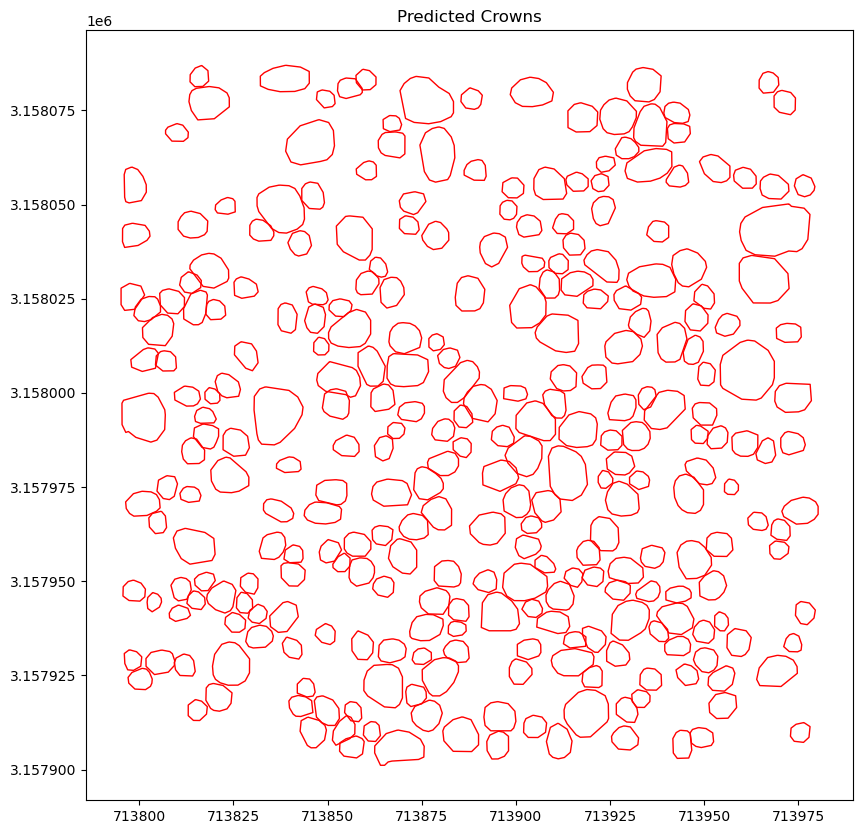

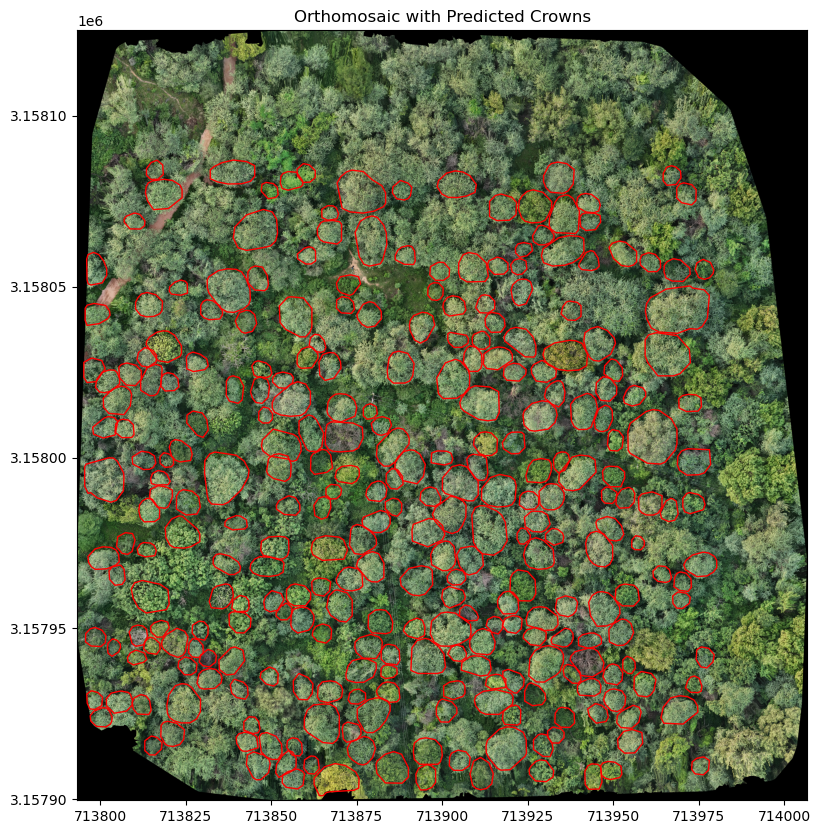

In [23]:
import matplotlib.pyplot as plt
import geopandas as gpd
import rasterio
from rasterio.plot import show

# Assuming crowns is your GeoDataFrame with predicted crown geometries
# If you want to see just the crowns:
fig, ax = plt.subplots(figsize=(10, 10))
crowns9.plot(ax=ax, facecolor='none', edgecolor='red')
ax.set_title("Predicted Crowns")
plt.show()

# Alternatively, if you'd like to overlay the crowns on the original image:
# Open the original orthomosaic image using rasterio
img_path = site_path + "s3.tif"
with rasterio.open(img_path) as src:
    fig, ax = plt.subplots(figsize=(10, 10))
    show(src, ax=ax)
    crowns9.plot(ax=ax, facecolor='none', edgecolor='red')
    ax.set_title("Orthomosaic with Predicted Crowns")
    plt.show()


In [28]:
import matplotlib.pyplot as plt
import geopandas as gpd
import rasterio
from rasterio.plot import show

# Define output path
output_path = "overlaid_crowns.png"  # or .jpg

# Load your image
img_path = site_path + "converted_image.tif"
with rasterio.open(img_path) as src:
    fig, ax = plt.subplots(figsize=(10, 10))
    show(src, ax=ax)
    crowns9.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1)
    ax.set_title("Orthomosaic with Predicted Crowns")
    plt.axis('off')
    
    # Save figure
    plt.savefig(output_path, dpi=300, bbox_inches='tight', pad_inches=0.1)
    plt.close(fig)

print(f"✅ Saved overlaid image to: {output_path}")


✅ Saved overlaid image to: overlaid_crowns.png


In [26]:
import geopandas as gpd

# Input GPKG file
gpkg_file = "D:/Gaurav/2crowns9_map.gpkg"

# Read the GPKG
gdf = gpd.read_file(gpkg_file)

# Save as GeoJSON
geojson_file = "D:/Gaurav/s3.geojson"
gdf.to_file(geojson_file, driver="GeoJSON")

print(f"Converted {gpkg_file} → {geojson_file}")


Converted D:/Gaurav/2crowns9_map.gpkg → D:/Gaurav/s3.geojson


In [28]:
import geopandas as gpd
import simplekml

# Load GeoJSON
gdf = gpd.read_file(r"D:\Gaurav\s3.geojson")

# Ensure WGS84 for KML
gdf = gdf.to_crs(epsg=4326)

# Create KML
kml = simplekml.Kml()

for _, row in gdf.iterrows():
    geom = row.geometry
    if geom.geom_type == "Point":
        kml.newpoint(name=str(row.get("id", "")), coords=[(geom.x, geom.y)])
    elif geom.geom_type in ["LineString", "MultiLineString"]:
        kml.newlinestring(name=str(row.get("id", "")), coords=list(geom.coords))
    elif geom.geom_type in ["Polygon", "MultiPolygon"]:
        if geom.geom_type == "Polygon":
            coords = list(geom.exterior.coords)
        else:
            coords = list(geom.geoms[0].exterior.coords)
        kml.newpolygon(name=str(row.get("id", "")), outerboundaryis=coords)

# Save KML
kml.save(r"D:\Gaurav\s3.kml")


OM2: | 0.02, 0.00, 714261.73|
| 0.00,-0.02, 3159731.32|
| 0.00, 0.00, 1.00|
OM1: | 0.02, 0.00, 714257.62|
| 0.00,-0.02, 3159734.16|
| 0.00, 0.00, 1.00|
EPSG:32643
EPSG:32643


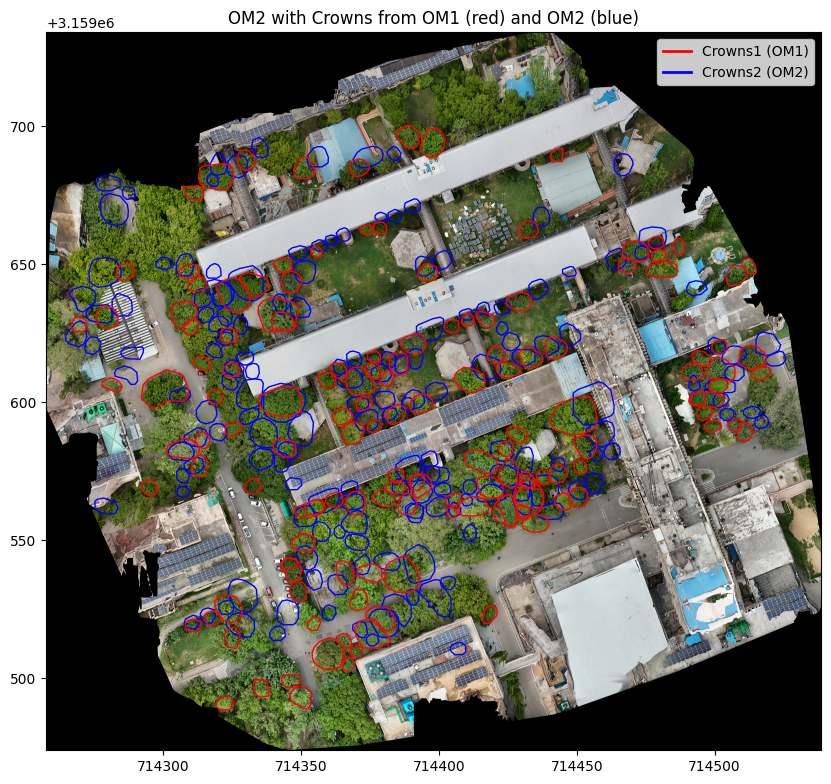

In [11]:
import os
import matplotlib.pyplot as plt
import geopandas as gpd
import rasterio
from rasterio.plot import show

# Load saved crown predictions
crowns1 = gpd.read_file("tiles/crowns6_map.gpkg")
crowns2 = gpd.read_file("tiles/crowns7_map.gpkg")

# Path to orthomosaic image (OM2)
img_path = site_path + "sit_om6.tif"
img_path2 = site_path + "sit_om4.tif"

# Plot the orthomosaic and overlay both sets of predictions
with rasterio.open(img_path2) as src1:
    print("OM2:", src1.transform)
with rasterio.open(img_path) as src:
    fig, ax = plt.subplots(figsize=(10, 10))

    # Show orthomosaic
    show(src, ax=ax)
    raster_crs = src.crs

    # Reproject crowns to match the raster CRS
    if crowns2.crs != raster_crs:
        crowns2 = crowns2.to_crs(raster_crs)
    if crowns1.crs != raster_crs:
        crowns1 = crowns1.to_crs(raster_crs)
    print("OM1:", src.transform)

    
    print(crowns1.crs)
    print(crowns2.crs)
     # Overlay crowns2 (from OM2) in blue
    crowns2.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='Crowns2 (OM2)')
    # Overlay crowns1 (from OM1) in red
    crowns1.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='Crowns1 (OM1)')

   

    ax.set_title("OM2 with Crowns from OM1 (red) and OM2 (blue)")
    plt.legend(handles=[
        plt.Line2D([0], [0], color='red', label='Crowns1 (OM1)', linewidth=2),
        plt.Line2D([0], [0], color='blue', label='Crowns2 (OM2)', linewidth=2)
    ])
    plt.show()

Median shifting

Applying median translation: dx = 3.21, dy = -1.00


c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
C:\Users\DELL\AppData\Local\Temp\ipykernel_39088\948902018.py:71: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
C:\Users\DELL\AppData\Local\Temp\ipykernel_39088\948902018.py:71: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


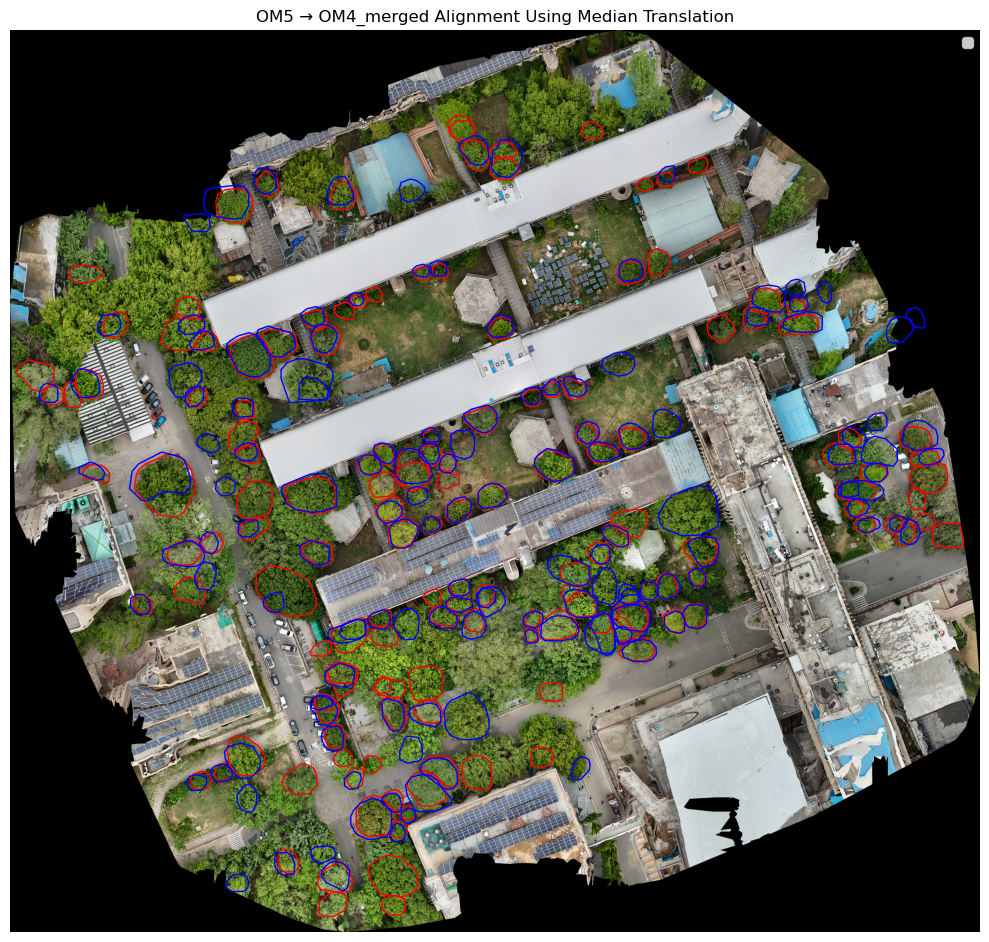

IoU between OM4_merged crown 35 and OM5 crown 129: 0.0000 (0.00%)


In [1]:
import geopandas as gpd
import numpy as np
from shapely.affinity import translate
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show

# --- Load Data ---
site_path = "large_files/"
img_path_om3 = site_path + "sit_om5.tif"
crowns_om3 = gpd.read_file("tiles/crowns5_map.gpkg")  # reference crowns (OM3)
crowns_om4 = gpd.read_file("tiles/crowns6_map.gpkg")  # shifted crowns (OM4)

# --- Match CRS ---
with rasterio.open(img_path_om3) as src:
    crs_target = src.crs

crowns_om3 = crowns_om3.to_crs(crs_target)
crowns_om4 = crowns_om4.to_crs(crs_target)

# --- Get Centroids ---
centroids_om3 = np.array([[geom.centroid.x, geom.centroid.y] for geom in crowns_om3.geometry])
centroids_om4 = np.array([[geom.centroid.x, geom.centroid.y] for geom in crowns_om4.geometry])

# --- Nearest Neighbor Matching ---
nn = NearestNeighbors(n_neighbors=1).fit(centroids_om3)  # OM3 = reference
distances, indices = nn.kneighbors(centroids_om4)

threshold = 10  # meters
matched = [(indices[i][0], i) for i in range(len(distances)) if distances[i][0] < threshold]


if len(matched) < 3:
    raise ValueError("Not enough matched crowns found for reliable alignment.")

# --- Compute Median Translation Vector from Matched Pairs ---
shifts = []
for i_om3, i_om4 in matched:
    p = centroids_om3[i_om3]
    q = centroids_om4[i_om4]
    dx, dy = p - q
    shifts.append((dx, dy))


shifts = np.array(shifts)
# Optional filtering step before computing the median shift
residuals = np.linalg.norm(shifts, axis=1)
inliers = residuals < np.percentile(residuals, 90)  # Keep top 90% closest
dx, dy = np.median(shifts[inliers], axis=0)
#------initially i was getting 80.34%IOU when above 3 lines were Not used and below line was used------------
# dx, dy = np.median(shifts, axis=0)  # Robust translation 

print(f"Applying median translation: dx = {dx:.2f}, dy = {dy:.2f}")

# --- Apply Global Translation ---
crowns_om4['geometry'] = crowns_om4['geometry'].apply(lambda g: translate(g, xoff=dx, yoff=dy))

# --- Save Aligned OM3 ---
crowns_om4.to_file("tiles/crowns6_aligned.gpkg", driver="GPKG")

# --- Plotting ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path_om3) as src:
    show(src, ax=ax)

crowns_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3 aligned')
crowns_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4 reference')

ax.set_title("OM5 → OM4_merged Alignment Using Median Translation")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()

# --- IoU Evaluation for Specific Crowns ---
id_om3, id_om4 = 35, 129
if id_om3 < len(crowns_om3) and id_om4 < len(crowns_om4):
    g1 = crowns_om3.loc[id_om3].geometry
    g2 = crowns_om4.loc[id_om4].geometry
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    iou = inter / union if union > 0 else 0
    print(f"IoU between OM4_merged crown {id_om3} and OM5 crown {id_om4}: {iou:.4f} ({iou*100:.2f}%)")
else:
    print("Invalid crown indices for IoU check.")


Applying median translation: dx = -0.00, dy = -0.00


c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
C:\Users\DELL\AppData\Local\Temp\ipykernel_39088\1736187811.py:82: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
C:\Users\DELL\AppData\Local\Temp\ipykernel_39088\1736187811.py:82: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


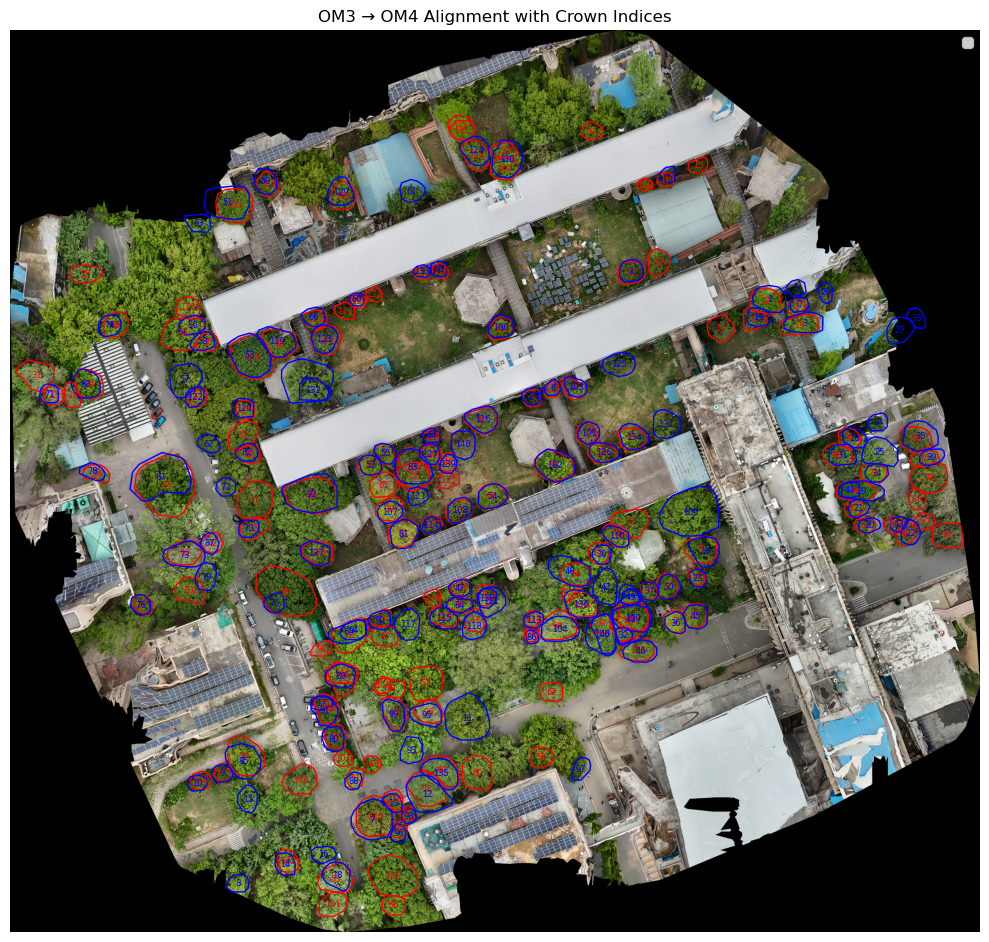

IoU between OM3 crown 36 and OM4 crown 139: 0.0000 (0.00%)


In [6]:
import geopandas as gpd
import numpy as np
from shapely.affinity import translate
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show

# --- Load Data ---
site_path = "large_files/"
img_path_om3 = site_path + "sit_om5.tif"
crowns_om3 = gpd.read_file("tiles/crowns5_map.gpkg")  # reference crowns (OM3)
crowns_om4 = gpd.read_file("tiles/crowns6_aligned.gpkg")  # shifted crowns (OM4)

# --- Match CRS ---
with rasterio.open(img_path_om3) as src:
    crs_target = src.crs

crowns_om3 = crowns_om3.to_crs(crs_target)
crowns_om4 = crowns_om4.to_crs(crs_target)

# --- Get Centroids ---
centroids_om3 = np.array([[geom.centroid.x, geom.centroid.y] for geom in crowns_om3.geometry])
centroids_om4 = np.array([[geom.centroid.x, geom.centroid.y] for geom in crowns_om4.geometry])

# --- Nearest Neighbor Matching ---
nn = NearestNeighbors(n_neighbors=1).fit(centroids_om3)  # OM3 = reference
distances, indices = nn.kneighbors(centroids_om4)

threshold = 10  # meters
matched = [(indices[i][0], i) for i in range(len(distances)) if distances[i][0] < threshold]


if len(matched) < 3:
    raise ValueError("Not enough matched crowns found for reliable alignment.")

# --- Compute Median Translation Vector from Matched Pairs ---
shifts = []
for i_om3, i_om4 in matched:
    p = centroids_om3[i_om3]
    q = centroids_om4[i_om4]
    dx, dy = p - q
    shifts.append((dx, dy))


shifts = np.array(shifts)
# Optional filtering step before computing the median shift
residuals = np.linalg.norm(shifts, axis=1)
inliers = residuals < np.percentile(residuals, 90)  # Keep top 90% closest
dx, dy = np.median(shifts[inliers], axis=0)
#------initially i was getting 80.34%IOU when above 3 lines were Not used and below line was used------------
# dx, dy = np.median(shifts, axis=0)  # Robust translation 

print(f"Applying median translation: dx = {dx:.2f}, dy = {dy:.2f}")

# --- Apply Global Translation ---
crowns_om4['geometry'] = crowns_om4['geometry'].apply(lambda g: translate(g, xoff=dx, yoff=dy))

# --- Save Aligned OM3 ---
crowns_om4.to_file("tiles/crowns6_aligned.gpkg", driver="GPKG")
# --- Plotting ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path_om3) as src:
    show(src, ax=ax)

# Plot the crowns
crowns_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3 aligned')
crowns_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4 reference')

# Annotate OM3 crowns
for idx, row in crowns_om3.iterrows():
    x, y = row.geometry.centroid.coords[0]
    ax.annotate(str(idx), (x, y), color='red', fontsize=6, ha='center', va='center')

# Annotate OM4 crowns
for idx, row in crowns_om4.iterrows():
    x, y = row.geometry.centroid.coords[0]
    ax.annotate(str(idx), (x, y), color='blue', fontsize=6, ha='center', va='center')

# Final touches
ax.set_title("OM3 → OM4 Alignment with Crown Indices")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()


# --- IoU Evaluation for Specific Crowns ---
id_om3, id_om4 = 36, 139
if id_om3 < len(crowns_om3) and id_om4 < len(crowns_om4):
    g1 = crowns_om3.loc[id_om3].geometry
    g2 = crowns_om4.loc[id_om4].geometry
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    iou = inter / union if union > 0 else 0
    print(f"IoU between OM3 crown {id_om3} and OM4 crown {id_om4}: {iou:.4f} ({iou*100:.2f}%)")
else:
    print("Invalid crown indices for IoU check.")


c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\rasterio\plot.py:112: NodataShadowWarning: The dataset's nodata attribute is shadowing the alpha band. All masks will be determined by the nodata attribute
  arr = source.read(rgb_indexes, masked=True)


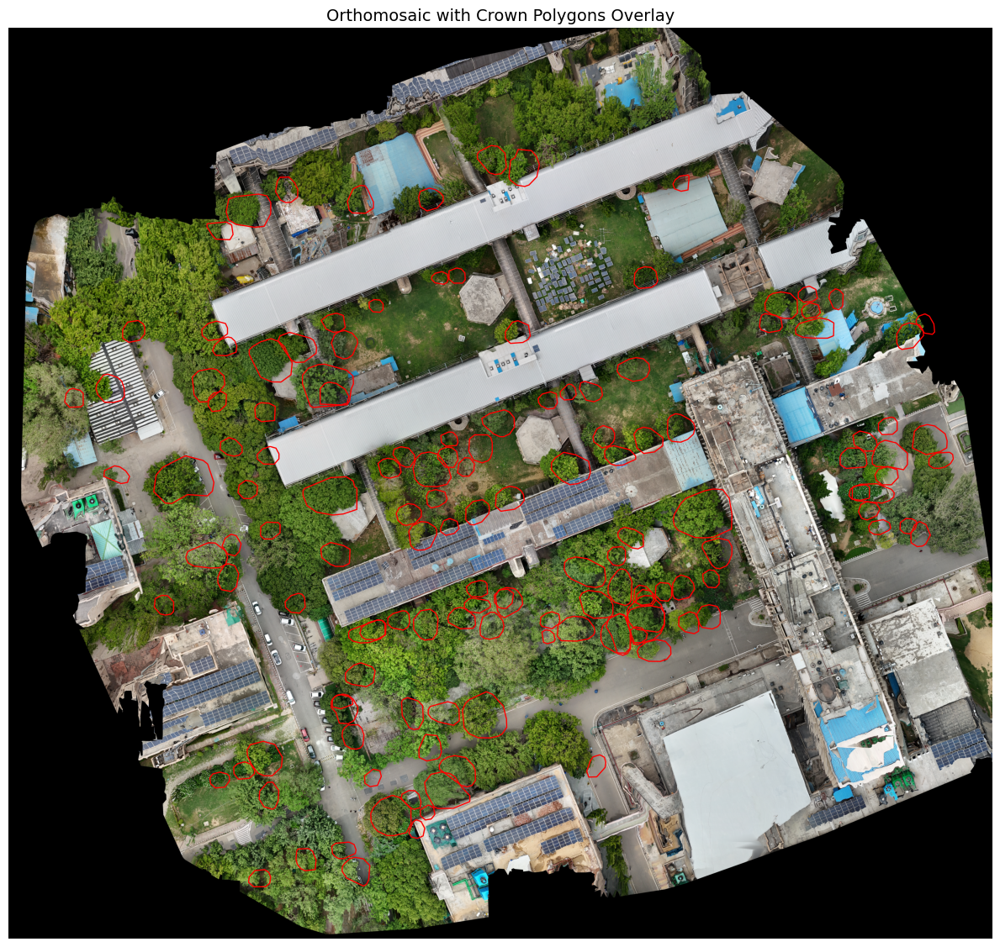

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show

# --- File paths ---
img_path = "large_files/om4.tif"   # orthomosaic raster
crowns_path = "tiles/crowns6_aligned.gpkg"     # aligned crowns

# --- Load crowns ---
crowns = gpd.read_file(crowns_path)

# --- Plot ---
fig, ax = plt.subplots(figsize=(12, 12))

# Show raster
with rasterio.open(img_path) as src:
    show(src, ax=ax)

# Overlay crowns
crowns.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1)

# Style
ax.set_title("Orthomosaic with Crown Polygons Overlay", fontsize=14)
ax.axis("off")
plt.tight_layout()
plt.show()


In [9]:
import rasterio

with rasterio.open("large_files/sit_om6.tif") as src:
    print("Original transform:", src.transform)

with rasterio.open("om6_shifted_3.tif") as src:
    print("Shifted transform:", src.transform)


Original transform: | 0.02, 0.00, 714257.62|
| 0.00,-0.02, 3159734.16|
| 0.00, 0.00, 1.00|
Shifted transform: | 0.02, 0.00, 714253.96|
| 0.00,-0.02, 3159732.93|
| 0.00, 0.00, 1.00|


create crowns with 0 IOU 

c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operation

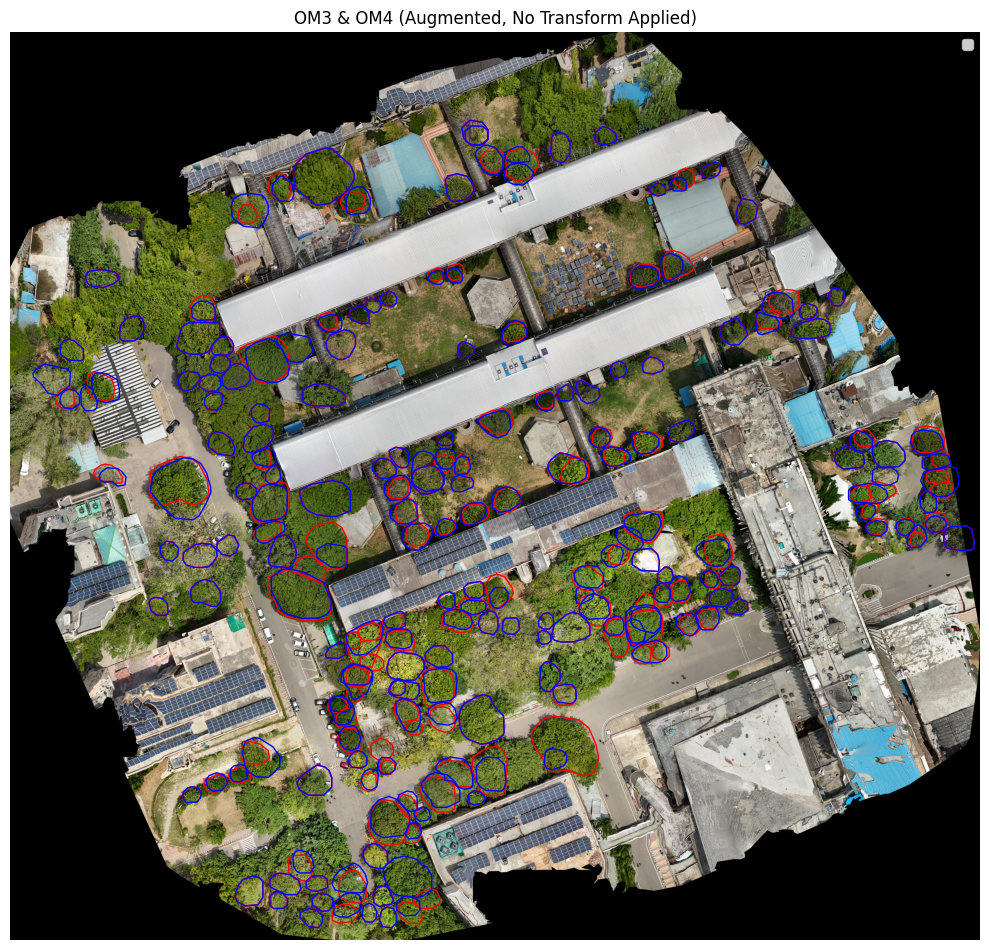

In [6]:
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show
from sklearn.neighbors import NearestNeighbors
import pandas as pd

# --- Load data ---
site_path = "large_files/"
img_path_om3 = site_path + "sit_om4.tif"
crowns_om4 = gpd.read_file("tiles/crowns5_aligned.gpkg")
crowns_om3 = gpd.read_file("tiles/crowns4_map.gpkg")

# --- Match CRS ---
with rasterio.open(img_path_om3) as src:
    crs_target = src.crs

crowns_om3 = crowns_om3.to_crs(crs_target)
crowns_om4 = crowns_om4.to_crs(crs_target)

# --- IoU function ---
def compute_iou(g1, g2):
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    return inter / union if union > 0 else 0.0

# --- Augment OM3 and OM4 without any affine transform ---
augmented_om3 = crowns_om3.copy()
augmented_om4 = crowns_om4.copy()

# Add OM3 crowns to OM4 if missing (no transform needed)
for idx, row in crowns_om3.iterrows():
    if all(compute_iou(row.geometry, g2) < 0.01 for g2 in crowns_om4.geometry):
        new_row = row.copy()
        new_row['origin'] = 'from_om3'
        augmented_om4 = pd.concat([augmented_om4, gpd.GeoDataFrame([new_row], crs=augmented_om4.crs)], ignore_index=True)

# Add OM4 crowns to OM3 if missing (no transform needed)
for idx, row in crowns_om4.iterrows():
    if all(compute_iou(row.geometry, g2) < 0.01 for g2 in crowns_om3.geometry):
        new_row = row.copy()
        new_row['origin'] = 'from_om4'
        augmented_om3 = pd.concat([augmented_om3, gpd.GeoDataFrame([new_row], crs=augmented_om3.crs)], ignore_index=True)

# --- Save updated GeoPackages ---
augmented_om3.to_file("tiles/crowns4_5_augmented.gpkg", driver="GPKG")
augmented_om4.to_file("tiles/crowns5_augmented.gpkg", driver="GPKG")

# --- Plot ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path_om3) as src:
    show(src, ax=ax)

augmented_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3')
augmented_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4')
ax.set_title("OM3 & OM4 (Augmented, No Transform Applied)")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()


In [44]:
# import geopandas as gpd
# import numpy as np
# import matplotlib.pyplot as plt
# import rasterio
# from rasterio.plot import show
# from sklearn.neighbors import NearestNeighbors
# import pandas as pd

# # --- Load data ---
# site_path = "large_files/"
# img_path_om4 = site_path + "sit_om4.tif"
# crowns_om3 = gpd.read_file("tiles/crowns3_aligned.gpkg")
# crowns_om4 = gpd.read_file("tiles/crowns4_map.gpkg")

# # --- Match CRS ---
# with rasterio.open(img_path_om4) as src:
#     crs_target = src.crs

# crowns_om3 = crowns_om3.to_crs(crs_target)
# crowns_om4 = crowns_om4.to_crs(crs_target)

# # --- IoU function ---
# def compute_iou(g1, g2):
#     inter = g1.intersection(g2).area
#     union = g1.union(g2).area
#     return inter / union if union > 0 else 0.0

# # --- Augment OM3 and OM4 without any affine transform ---
# augmented_om3 = crowns_om3.copy()
# augmented_om4 = crowns_om4.copy()

# # Add OM3 crowns to OM4 if missing (no transform needed)
# for idx, row in crowns_om3.iterrows():
#     if all(compute_iou(row.geometry, g2) < 0.01 for g2 in crowns_om4.geometry):
#         new_row = row.copy()
#         new_row['origin'] = 'from_om3'
#         augmented_om4 = pd.concat([augmented_om4, gpd.GeoDataFrame([new_row], crs=augmented_om4.crs)], ignore_index=True)

# # Add OM4 crowns to OM3 if missing (no transform needed)
# for idx, row in crowns_om4.iterrows():
#     if all(compute_iou(row.geometry, g2) < 0.01 for g2 in crowns_om3.geometry):
#         new_row = row.copy()
#         new_row['origin'] = 'from_om4'
#         augmented_om3 = pd.concat([augmented_om3, gpd.GeoDataFrame([new_row], crs=augmented_om3.crs)], ignore_index=True)

# # --- Save updated GeoPackages ---
# augmented_om3.to_file("tiles/crowns3_augmented.gpkg", driver="GPKG")
# augmented_om4.to_file("tiles/crowns4_augmented.gpkg", driver="GPKG")

# # --- Plot ---
# fig, ax = plt.subplots(figsize=(10, 10))
# with rasterio.open(img_path_om4) as src:
#     show(src, ax=ax)

# augmented_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3')
# augmented_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4')
# ax.set_title("OM3 & OM4 (Augmented, No Transform Applied)")
# plt.legend()
# plt.axis('off')
# plt.tight_layout()
# plt.show()

In [11]:

# import geopandas as gpd
# import numpy as np
# import pandas as pd
# from shapely.affinity import affine_transform
# from shapely.ops import unary_union
# from sklearn.neighbors import NearestNeighbors
# import matplotlib.pyplot as plt
# import rasterio
# from rasterio.plot import show

# # --- Load Data ---
# site_path = "large_files/"
# img_path_om3 = site_path + "sit_om3.tif"
# crowns_om3 = gpd.read_file("tiles/crowns3_augmented.gpkg")  # Shifted crowns (OM3)
# crowns_om4 = gpd.read_file("tiles/crowns4_augmented.gpkg")  # Reference crowns (OM4)

# # --- Match CRS ---
# with rasterio.open(img_path_om3) as src:
#     crs_target = src.crs

# crowns_om3 = crowns_om3.to_crs(crs_target)
# crowns_om4 = crowns_om4.to_crs(crs_target)

# # --- Get Centroids ---
# centroids_om3 = np.array([[geom.centroid.x, geom.centroid.y] for geom in crowns_om3.geometry])
# centroids_om4 = np.array([[geom.centroid.x, geom.centroid.y] for geom in crowns_om4.geometry])

# # --- Nearest Neighbors Matching ---
# nn = NearestNeighbors(n_neighbors=1).fit(centroids_om3)
# distances, indices = nn.kneighbors(centroids_om4)

# threshold = 10  # meters
# matched = [(i, indices[i][0]) for i in range(len(distances)) if distances[i][0] < threshold]
# if len(matched) < 3:
#     raise ValueError("Not enough matched crowns found for alignment.")

# # --- Compute Affine Transformation OM3 → OM4 ---
# def compute_affine(P, Q):
#     P_mean = P.mean(axis=0)
#     Q_mean = Q.mean(axis=0)
#     P_centered = P - P_mean
#     Q_centered = Q - Q_mean
#     U, _, Vt = np.linalg.svd(P_centered.T @ Q_centered)
#     R = U @ Vt
#     s = np.linalg.norm(Q_centered) / np.linalg.norm(P_centered)
#     t = Q_mean - s * R @ P_mean
#     return R, t, s

# P = np.array([centroids_om4[i] for i, _ in matched])  # OM4 (to align)
# Q = np.array([centroids_om3[j] for _, j in matched])  # OM3 (reference)

# R, t, s = compute_affine(P, Q)

# # Convert to Shapely affine matrix
# a, b = s * R[0, 0], s * R[0, 1]
# d, e = s * R[1, 0], s * R[1, 1]
# xoff, yoff = t
# affine_mat = [a, b, d, e, xoff, yoff]

# # --- Apply Affine to OM4 Crowns ---
# crowns_om4['geometry'] = crowns_om4['geometry'].apply(lambda g: affine_transform(g, affine_mat))

# # --- IoU Function ---
# def compute_iou(g1, g2):
#     inter = g1.intersection(g2).area
#     union = g1.union(g2).area
#     return inter / union if union > 0 else 0.0

# # --- Build IoU Matrix ---
# iou_matrix = np.zeros((len(crowns_om3), len(crowns_om4)))
# for i, g3 in enumerate(crowns_om3.geometry):
#     for j, g4 in enumerate(crowns_om4.geometry):
#         iou_matrix[i, j] = compute_iou(g3, g4)

# # --- Merge crowns with IoU > threshold(currently 0.7) ---
# merged_geoms = []

# merged_om3 = crowns_om3.copy()
# merged_om4 = crowns_om4.copy()

# high_iou_pairs = []

# for i in range(len(crowns_om3)):
#     for j in range(len(crowns_om4)):
#         if iou_matrix[i, j] > 0.70:
#             # Merge and store in list
#             merged_geom = crowns_om3.geometry.iloc[i].union(crowns_om4.geometry.iloc[j])
#             merged_geoms.append((i, j, merged_geom))
#             high_iou_pairs.append((i, j))

# # Replace matched geometries in both GeoDataFrames with the unioned geometry
# for i, j, merged_geom in merged_geoms:
#     merged_om3.at[i, 'geometry'] = merged_geom
#     merged_om4.at[j, 'geometry'] = merged_geom

# # Overwrite original variables with updated merged geometries
# crowns_om3 = merged_om3
# crowns_om4 = merged_om4


# # --- Compute A−B and B−A Differences ---
# iou_threshold = 0.1
# ab_diffs = []
# ba_diffs = []


# q = 50.0  # Area threshold in m² to ignore small slivers

# for i, geom3 in enumerate(crowns_om3.geometry):
#     overlapping_om4 = [j for j in range(len(crowns_om4)) if iou_matrix[i, j] > iou_threshold]
#     if overlapping_om4:
#         union_om4 = crowns_om4.geometry.iloc[overlapping_om4].unary_union
#         if geom3.area >= union_om4.area:
#             diff_geom = geom3.difference(union_om4)
#             if not diff_geom.is_empty and diff_geom.area >= q:
#                 ab_diffs.append(diff_geom)
#         else:
#             diff_geom = union_om4.difference(geom3)
#             if not diff_geom.is_empty and diff_geom.area >= q:
#                 ba_diffs.append(diff_geom)


# # --- Plotting ---
# fig, ax = plt.subplots(figsize=(10, 10))
# with rasterio.open(img_path_om4) as src:
#     show(src, ax=ax)

# # Outline crowns
# crowns_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3 aligned')
# crowns_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4 reference')

# # Plot A−B (yellow) and B−A (purple)
# gpd.GeoSeries(ab_diffs, crs=crs_target).plot(ax=ax, facecolor='yellow', edgecolor='black', linewidth=0.8, label='OM3 - OM4')
# gpd.GeoSeries(ba_diffs, crs=crs_target).plot(ax=ax, facecolor='purple', edgecolor='black', linewidth=0.8, label='OM4 - OM3')

# # Final touches
# ax.set_title("Only A−B and B−A Filled | Aligned Crowns Outlined")
# plt.legend()
# plt.axis('off')
# plt.tight_layout()
# plt.show()

merging high iou crowns and making A-B and B-A with condition

c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
C:\Users\DELL\AppData\Local\Temp\ipykernel_30064\1006884614.py:62: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  union_om4 = crowns_om4.geometry.iloc[overlapping_om4].unary_union
C:\Users\DELL\AppData\Local\Temp\ipykernel_30064\1006884614.py:86: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


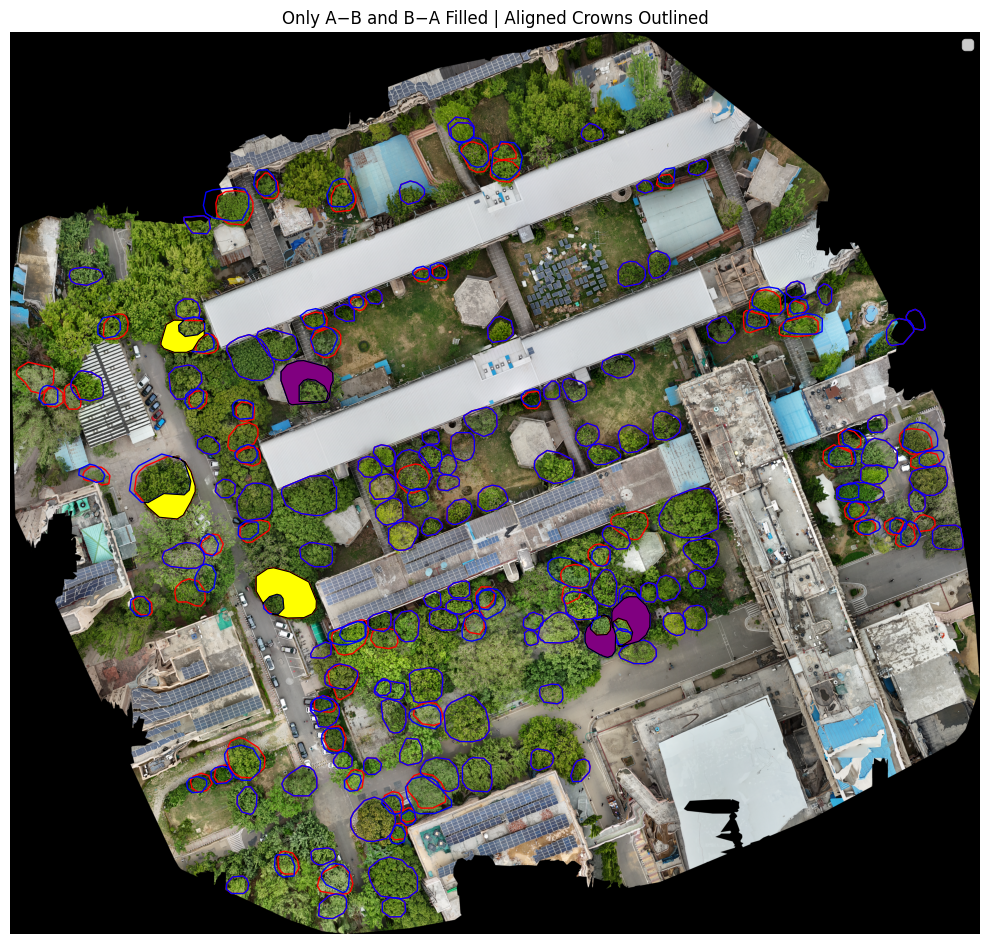

In [7]:
import geopandas as gpd
import numpy as np
import pandas as pd
from shapely.ops import unary_union
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show

# --- Load Data ---
site_path = "large_files/"
img_path_om3 = site_path + "sit_om5.tif"
crowns_om3 = gpd.read_file("tiles/crowns5_6_augmented.gpkg")  # Reference crowns (OM3)
crowns_om4 = gpd.read_file("tiles/crowns6_augmented.gpkg")  # Aligned crowns (OM4)

# --- Match CRS ---
with rasterio.open(img_path_om3) as src:
    crs_target = src.crs

crowns_om3 = crowns_om3.to_crs(crs_target)
crowns_om4 = crowns_om4.to_crs(crs_target)

# --- IoU Function ---
def compute_iou(g1, g2):
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    return inter / union if union > 0 else 0.0

# --- Build IoU Matrix ---
iou_matrix = np.zeros((len(crowns_om3), len(crowns_om4)))
for i, g3 in enumerate(crowns_om3.geometry):
    for j, g4 in enumerate(crowns_om4.geometry):
        iou_matrix[i, j] = compute_iou(g3, g4)

# --- Merge crowns with IoU > threshold (e.g., 0.7) ---
merged_geoms = []
merged_om3 = crowns_om3.copy()
merged_om4 = crowns_om4.copy()

for i in range(len(crowns_om3)):
    for j in range(len(crowns_om4)):
        if iou_matrix[i, j] > 0.70:
            merged_geom = crowns_om3.geometry.iloc[i].union(crowns_om4.geometry.iloc[j])
            merged_geoms.append((i, j, merged_geom))

for i, j, merged_geom in merged_geoms:
    merged_om3.at[i, 'geometry'] = merged_geom
    merged_om4.at[j, 'geometry'] = merged_geom

crowns_om3 = merged_om3
crowns_om4 = merged_om4

# --- Compute A−B and B−A Differences ---
iou_threshold = 0.1
ab_diffs = []
ba_diffs = []

q = 50.0  # Area threshold to ignore small slivers

for i, geom3 in enumerate(crowns_om3.geometry):
    overlapping_om4 = [j for j in range(len(crowns_om4)) if iou_matrix[i, j] > iou_threshold]
    if overlapping_om4:
        union_om4 = crowns_om4.geometry.iloc[overlapping_om4].unary_union
        if geom3.area >= union_om4.area:
            diff_geom = geom3.difference(union_om4)
            if not diff_geom.is_empty and diff_geom.area >= q:
                ab_diffs.append(diff_geom)
        else:
            diff_geom = union_om4.difference(geom3)
            if not diff_geom.is_empty and diff_geom.area >= q:
                ba_diffs.append(diff_geom)

# --- Plotting ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path_om3) as src:
    show(src, ax=ax)

# Outline crowns
crowns_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3 (Reference)')
crowns_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4 (Aligned)')

# Plot A−B (yellow) and B−A (purple)
gpd.GeoSeries(ab_diffs, crs=crs_target).plot(ax=ax, facecolor='yellow', edgecolor='black', linewidth=0.8, label='OM3 - OM4')
gpd.GeoSeries(ba_diffs, crs=crs_target).plot(ax=ax, facecolor='purple', edgecolor='black', linewidth=0.8, label='OM4 - OM3')

ax.set_title("Only A−B and B−A Filled | Aligned Crowns Outlined")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()


c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.52723109 0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]


C:\Users\DELL\AppData\Local\Temp\ipykernel_30064\1951191170.py:67: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  union_om4 = crowns_om4.geometry.iloc[overlapping_om4].unary_union
C:\Users\DELL\AppData\Local\Temp\ipykernel_30064\1951191170.py:106: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


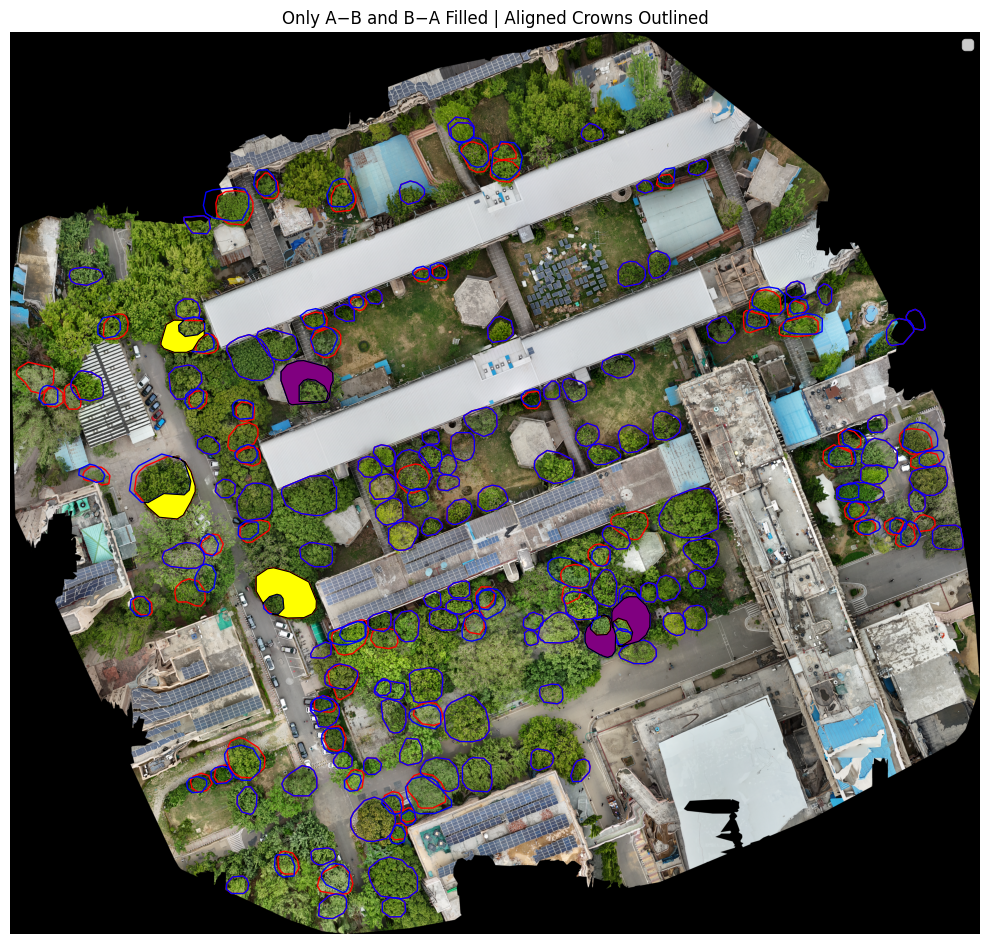

In [8]:
import geopandas as gpd
import numpy as np
import pandas as pd
from shapely.ops import unary_union
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show

# --- Load Data ---
site_path = "large_files/"
img_path_om3 = site_path + "sit_om5.tif"
crowns_om3 = gpd.read_file("tiles/crowns5_6_augmented.gpkg")  # Reference crowns (OM3)
crowns_om4 = gpd.read_file("tiles/crowns6_augmented.gpkg")  # Aligned crowns (OM4)

# --- Match CRS ---
with rasterio.open(img_path_om3) as src:
    crs_target = src.crs

crowns_om3 = crowns_om3.to_crs(crs_target)
crowns_om4 = crowns_om4.to_crs(crs_target)

# --- IoU Function ---
def compute_iou(g1, g2):
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    return inter / union if union > 0 else 0.0

# --- Build IoU Matrix ---
iou_matrix = np.zeros((len(crowns_om3), len(crowns_om4)))
for i, g3 in enumerate(crowns_om3.geometry):
    for j, g4 in enumerate(crowns_om4.geometry):
        iou_matrix[i, j] = compute_iou(g3, g4)
print(iou_matrix)
# --- Merge crowns with IoU > threshold (e.g., 0.7) ---
merged_geoms = []
merged_om3 = crowns_om3.copy()
merged_om4 = crowns_om4.copy()

for i in range(len(crowns_om3)):
    for j in range(len(crowns_om4)):
        if iou_matrix[i, j] > 0.70:
            merged_geom = crowns_om3.geometry.iloc[i].union(crowns_om4.geometry.iloc[j])
            merged_geoms.append((i, j, merged_geom))

for i, j, merged_geom in merged_geoms:
    merged_om3.at[i, 'geometry'] = merged_geom
    merged_om4.at[j, 'geometry'] = merged_geom

# Update main crown sets
crowns_om3 = merged_om3
crowns_om4 = merged_om4

# --- Save Merged Crowns ---
# crowns_om3.to_file("tiles/crowns4_5_merged.gpkg", driver="GPKG")
# crowns_om4.to_file("tiles/crowns5_merged.gpkg", driver="GPKG")

# --- Compute A−B and B−A Differences ---
iou_threshold = 0.1
ab_diffs = []
ba_diffs = []

q = 50.0 

for i, geom3 in enumerate(crowns_om3.geometry):
    overlapping_om4 = [j for j in range(len(crowns_om4)) if iou_matrix[i, j] > iou_threshold]
    if overlapping_om4:
        union_om4 = crowns_om4.geometry.iloc[overlapping_om4].unary_union
        if geom3.area >= union_om4.area:
            diff_geom = geom3.difference(union_om4)
            if not diff_geom.is_empty and diff_geom.area >= q:
                ab_diffs.append(diff_geom)
        else:
            diff_geom = union_om4.difference(geom3)
            if not diff_geom.is_empty and diff_geom.area >= q:
                ba_diffs.append(diff_geom)


# --- Append A−B and B−A to merged crowns ---
diff_geoms = ab_diffs + ba_diffs
diff_gdf = gpd.GeoDataFrame(geometry=diff_geoms, crs=crs_target)

# Combine with merged crowns
merged_all = pd.concat([crowns_om3, diff_gdf], ignore_index=True)

# Save to one file
merged_all.to_file("tiles/crowns5_6_merged.gpkg", driver="GPKG")

# Optionally save OM4 separately if needed
crowns_om4.to_file("tiles/crowns6_merged.gpkg", driver="GPKG")


# --- Plotting ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path_om3) as src:
    show(src, ax=ax)

# Outline crowns
crowns_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3 (Reference)')
crowns_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4 (Aligned)')

# Plot A−B (yellow) and B−A (purple)
gpd.GeoSeries(ab_diffs, crs=crs_target).plot(ax=ax, facecolor='yellow', edgecolor='black', linewidth=0.8, label='OM3 - OM4')
gpd.GeoSeries(ba_diffs, crs=crs_target).plot(ax=ax, facecolor='purple', edgecolor='black', linewidth=0.8, label='OM4 - OM3')

ax.set_title("Only A−B and B−A Filled | Aligned Crowns Outlined")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()


In [1]:
import shapely
import geopandas as gpd
print(shapely.__version__)
print(gpd.__version__)


1.8.5.post1
0.12.2


c:\Users\DELL\anaconda3\envs\drone1\lib\site-packages\geopandas\_compat.py:123: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


Creating same crowns which have IOU=0 crowns because when crowns are merged only single crown is left that is why create duplicate

In [1]:
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show
from sklearn.neighbors import NearestNeighbors
import pandas as pd

In [2]:
# --- Load data ---
site_path = "large_files/"

In [3]:
img_path_om3 = site_path + "sit_om6.tif"

In [4]:
crowns_om4 = gpd.read_file("tiles/crowns7_merged.gpkg")

In [5]:




crowns_om3 = gpd.read_file("tiles/crowns6_7_merged.gpkg")

In [6]:
# --- Match CRS ---
with rasterio.open(img_path_om3) as src:
    crs_target = src.crs

crowns_om3 = crowns_om3.to_crs(crs_target)
crowns_om4 = crowns_om4.to_crs(crs_target)

In [7]:
# --- IoU function ---
def compute_iou(g1, g2):
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    return inter / union if union > 0 else 0.0

In [8]:
# --- Augment OM3 and OM4 without any affine transform ---
augmented_om3 = crowns_om3.copy()
augmented_om4 = crowns_om4.copy()

In [9]:
# Add OM3 crowns to OM4 if missing or fully inside any OM4 crown
for idx, row in crowns_om3.iterrows():
    geometry = row.geometry
    has_high_iou = any(compute_iou(geometry, g2) >= 0.01 for g2 in crowns_om4.geometry)
    is_within_any = any(geometry.within(g2) for g2 in crowns_om4.geometry)

    if not has_high_iou or is_within_any:
        new_row = row.copy()
        new_row['origin'] = 'from_om3'
        augmented_om4 = pd.concat(
            [augmented_om4, gpd.GeoDataFrame([new_row], crs=augmented_om4.crs)],
            ignore_index=True
        )

    



In [10]:
# Add OM4 crowns to OM3 if missing or fully inside any OM3 crown
for idx, row in crowns_om4.iterrows():
    geometry = row.geometry
    has_high_iou = any(compute_iou(geometry, g2) >= 0.01 for g2 in crowns_om3.geometry)
    is_within_any = any(geometry.within(g2) for g2 in crowns_om3.geometry)

    if not has_high_iou or is_within_any:
        new_row = row.copy()
        new_row['origin'] = 'from_om4'
        augmented_om3 = pd.concat(
            [augmented_om3, gpd.GeoDataFrame([new_row], crs=augmented_om3.crs)],
            ignore_index=True
        )



In [ ]:
# --- Save updated GeoPackages ---
augmented_om3.to_file("tiles/crowns6_7_merged.gpkg", driver="GPKG")
augmented_om4.to_file("tiles/crowns7_merged.gpkg", driver="GPKG")

In [ ]:

# --- Plot ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path_om3) as src:
    show(src, ax=ax)

augmented_om3.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='OM3')
augmented_om4.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=1, label='OM4')
ax.set_title("OM3 & OM4 (Augmented, No Transform Applied)")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()


KeyboardInterrupt: 

Finding Consistent Crowns over all orthomosaic using graph

In [9]:

import geopandas as gpd
import numpy as np
import networkx as nx

# --- IOU Computation ---
def compute_iou(g1, g2):
    inter = g1.intersection(g2).area
    union = g1.union(g2).area
    return inter / union if union > 0 else 0.0

# --- Parameters ---
paths = [
    "tiles/crowns3_4_merged.gpkg",  # OM3
    "tiles/crowns4_5_merged.gpkg",  # OM4
    "tiles/crowns5_6_merged.gpkg",  # OM5
    "tiles/crowns6_7_merged.gpkg",  # OM6
    "tiles/crowns7_merged.gpkg"     # OM7
]

# --- Load all crowns ---
all_crowns = [gpd.read_file(p) for p in paths]

# --- Add time and node_id to each crown ---
for t, gdf in enumerate(all_crowns):
    gdf["time"] = t
    gdf["node_id"] = [f"{t}_{i}" for i in range(len(gdf))]

# Assign artificial crown_id to match across time (e.g., from previous merge process)
for t, gdf in enumerate(all_crowns):
    gdf["crown_id"] = gdf.index  # Temporary hack: use index as crown_id


# --- Build graph based on matching crown_id ---
G = nx.DiGraph()

for t in range(len(all_crowns) - 1):
    gdf1 = all_crowns[t]
    gdf2 = all_crowns[t + 1]

# Build a lookup for crown_id → node_id in next timestep
    crownid_to_node = {row["crown_id"]: row["node_id"] for _, row in gdf2.iterrows()}

    for _, row1 in gdf1.iterrows():
        node1 = row1["node_id"]
        cid = row1["crown_id"]
        if cid in crownid_to_node:
            node2 = crownid_to_node[cid]
            G.add_node(node1, time=t)
            G.add_node(node2, time=t + 1)
            G.add_edge(node1, node2, weight=1.0)  # Weight can be 1 or skipped


# --- Traverse from OM3 crowns and score paths ---
final_scores = {}
visited_nodes = set()

for node in G.nodes:
    if G.nodes[node]["time"] == 0:
        stack = [(node, [node], 0)]
        while stack:
            current, path, score = stack.pop()
            visited_nodes.update(path)
            children = list(G.successors(current))
            if not children:
                final_scores[path[0]] = max(final_scores.get(path[0], 0), len(set(G.nodes[n]["time"] for n in path)))
            else:
                for child in children:
                    stack.append((child, path + [child], score + 1))

# --- Extract consistent nodes from valid paths (score ≥ 3) ---
consistent_paths = [path for path, sc in final_scores.items() if sc >= 3]
consistent_node_ids = set()
for start in consistent_paths:
    stack = [start]
    while stack:
        current = stack.pop()
        consistent_node_ids.add(current)
        stack.extend(G.successors(current))

from collections import defaultdict

# --- Organize consistent crowns by orthomosaic (time index) ---
by_time = defaultdict(list)
for gdf in all_crowns:
    for _, row in gdf.iterrows():
        if row["node_id"] in consistent_node_ids:
            by_time[row["time"]].append(row)

# --- Save each orthomosaic's consistent crowns separately ---
for t in sorted(by_time.keys()):
    gdf_t = gpd.GeoDataFrame(by_time[t], crs=all_crowns[0].crs)
    gdf_t.to_file(f"tiles/final_consistent_om{t+3}.gpkg", driver="GPKG")  # OM3 starts at time=0
    print(f"Saved {len(gdf_t)} consistent crowns for OM{t+3}")



Saved 959 consistent crowns for OM3
Saved 959 consistent crowns for OM4
Saved 959 consistent crowns for OM5
Saved 363 consistent crowns for OM6
Saved 357 consistent crowns for OM7


/tmp/ipykernel_10071/2336851030.py:21: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
/tmp/ipykernel_10071/2336851030.py:21: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


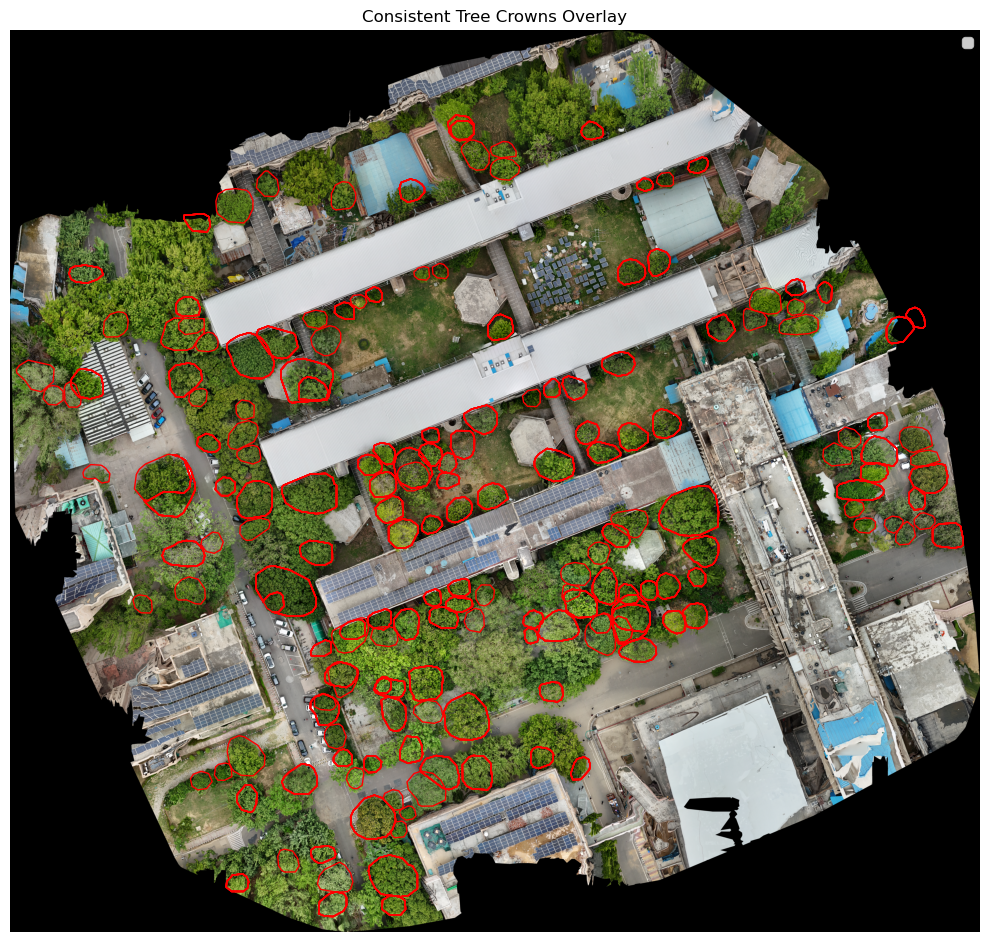

In [ ]:
import matplotlib.pyplot as plt
import geopandas as gpd
import rasterio
from rasterio.plot import show

# --- Paths ---
img_path = "large_files/sit_om5.tif"  # or change to sit_om4.tif etc. based on background
crowns_path = "tiles/final_consistent_om5.gpkg"

# --- Load crowns ---
crowns = gpd.read_file(crowns_path)

# --- Plot ---
fig, ax = plt.subplots(figsize=(10, 10))
with rasterio.open(img_path) as src:
    show(src, ax=ax)

crowns.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=1, label='Consistent Crowns')

ax.set_title("Consistent Tree Crowns Overlay")
plt.legend()
plt.axis('off')
plt.tight_layout()
plt.show()



In [7]:
# import geopandas as gpd
# import json

# # Load crowns
# crowns3 = gpd.read_file("tiles/crowns3_4_merged.gpkg")
# crowns4 = gpd.read_file("tiles/crowns4_5_merged.gpkg")
# crowns5 = gpd.read_file("tiles/crowns5_6_merged.gpkg")
# crowns6 = gpd.read_file("tiles/crowns6_7_merged.gpkg")

# # Put them in a dict for easy looping
# crown_dict = {
#     "c3": crowns3,
#     "c4": crowns4,
#     "c5": crowns5,
#     "c6": crowns6
# }

# # Function to compute IoU
# def compute_iou(poly1, poly2):
#     inter = poly1.intersection(poly2).area
#     union = poly1.union(poly2).area
#     return inter / union if union > 0 else 0

# # Collect overlaps
# overlap_results = []

# pairs = [("c3", "c4"), ("c4", "c5"), ("c5", "c6")]  # sequential comparisons

# for a, b in pairs:
#     gdf_a = crown_dict[a]
#     gdf_b = crown_dict[b]

#     for idx_a, geom_a in gdf_a.geometry.items():
#         matches = []
#         for idx_b, geom_b in gdf_b.geometry.items():
#             iou = compute_iou(geom_a, geom_b)
#             if iou > 0.3:
#                 matches.append((b, idx_b, round(iou, 3)))

#         if matches:
#             # Check if there’s a strong match >= 0.45
#             strong_matches = [m for m in matches if m[2] >= 0.45]

#             if strong_matches:
#                 # Keep only the one with maximum IoU
#                 best_match = max(strong_matches, key=lambda x: x[2])
#                 overlap_results.append((a, idx_a, [best_match]))
#             else:
#                 # No strong match, keep all weaker splits (>0.4)
#                 overlap_results.append((a, idx_a, matches))

# # Save results
# with open("overlap_results.json", "w") as f:
#     json.dump(overlap_results, f, indent=2)

# print(f"Saved {len(overlap_results)} overlap entries to overlap_results.json")

# # Print first 20 results
# for r in overlap_results[:20]:
#     a, idx_a, matches = r
#     print(f"{a}[{idx_a}] overlaps with:")
#     for m in matches:
#         print(f"   -> {m[0]}[{m[1]}], IoU={m[2]}")
#     print()

import geopandas as gpd
import json

# Load crowns
crowns3 = gpd.read_file("tiles/crowns3_4_merged.gpkg")
crowns4 = gpd.read_file("tiles/crowns4_5_merged.gpkg")
crowns5 = gpd.read_file("tiles/crowns5_6_merged.gpkg")
crowns6 = gpd.read_file("tiles/crowns6_7_merged.gpkg")

# Dictionary for looping
crown_dict = {
    "c3": crowns3,
    "c4": crowns4,
    "c5": crowns5,
    "c6": crowns6
}

# Function to compute IoU
def compute_iou(poly1, poly2):
    inter = poly1.intersection(poly2).area
    union = poly1.union(poly2).area
    return inter / union if union > 0 else 0

# Helper: find matches between two layers
def find_matches(gdf_a, gdf_b, idx_a, geom_a, strong_thr=0.58, weak_thr=0.40):
    matches = []
    for idx_b, geom_b in gdf_b.geometry.items():
        iou = compute_iou(geom_a, geom_b)
        if iou >= weak_thr:
            matches.append((idx_b, round(iou, 3)))

    if not matches:
        return []

    # strong case: keep only best match
    strong_matches = [m for m in matches if m[1] >= strong_thr]
    if strong_matches:
        return [max(strong_matches, key=lambda x: x[1])]
    else:
        return matches  # all weak ones are splits

# Build chains: c3 → c4 → c5 → c6
chains = []

for idx3, geom3 in crown_dict["c3"].geometry.items():
    chain = [("c3", idx3)]
    current_geom = geom3
    current_layer = "c3"

    for next_layer in ["c4", "c5", "c6"]:
        gdf_next = crown_dict[next_layer]
        matches = find_matches(crown_dict[current_layer], gdf_next, idx3, current_geom)

        if not matches:
            break  # no continuation, stop chain here

        # if multiple (splits), we branch into separate chains
        new_chains = []
        for m_idx, iou in matches:
            new_chain = chain + [(next_layer, m_idx, iou)]
            new_chains.append(new_chain)

        # If branching occurs, keep all branches
        if len(new_chains) > 1:
            for ch in new_chains:
                chains.append(ch)
            break  # stop this base chain, splits handled separately
        else:
            # continue with single best match
            chain = new_chains[0]
            current_geom = gdf_next.geometry[m_idx]
            current_layer = next_layer

    # store final chain
    chains.append(chain)

# Save results
with open("crown_chains.json", "w") as f:
    json.dump(chains, f, indent=2)

print(f"Saved {len(chains)} chains to crown_chains.json")

# Print first 20
for ch in chains[:20]:
    print(" → ".join([f"{layer}[{idx}]" if i == 0 else f"{layer}[{idx}], IoU={iou}" 
                      for i, (layer, idx, *rest) in enumerate(ch) 
                      for iou in ([rest[0]] if rest else [])]))


Saved 11958 chains to crown_chains.json
c4[73], IoU=0.429















c4[122], IoU=0.452
c4[321], IoU=0.452
c4[452], IoU=0.452
c4[531], IoU=0.452


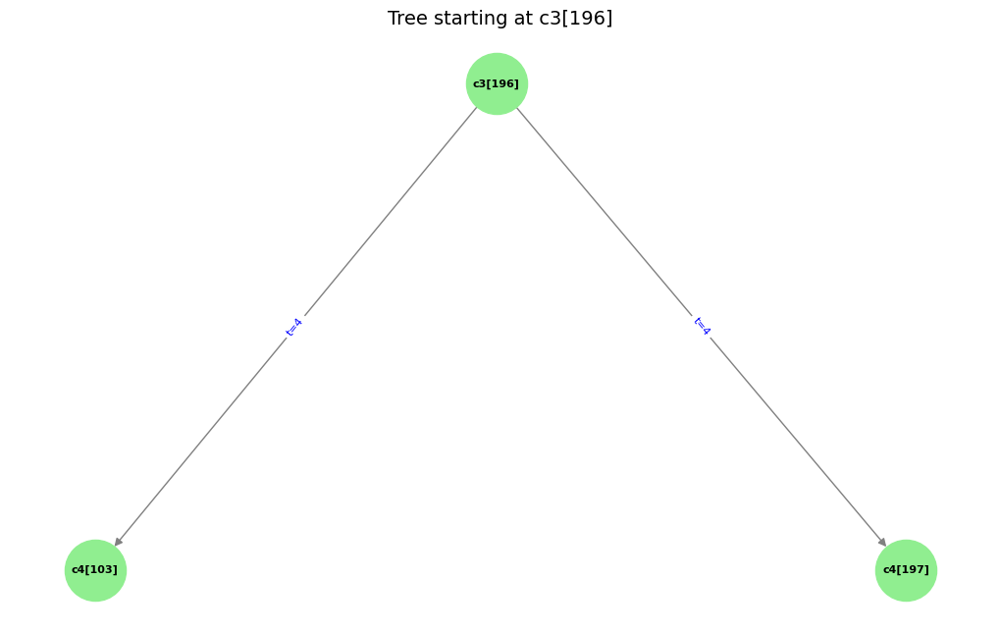

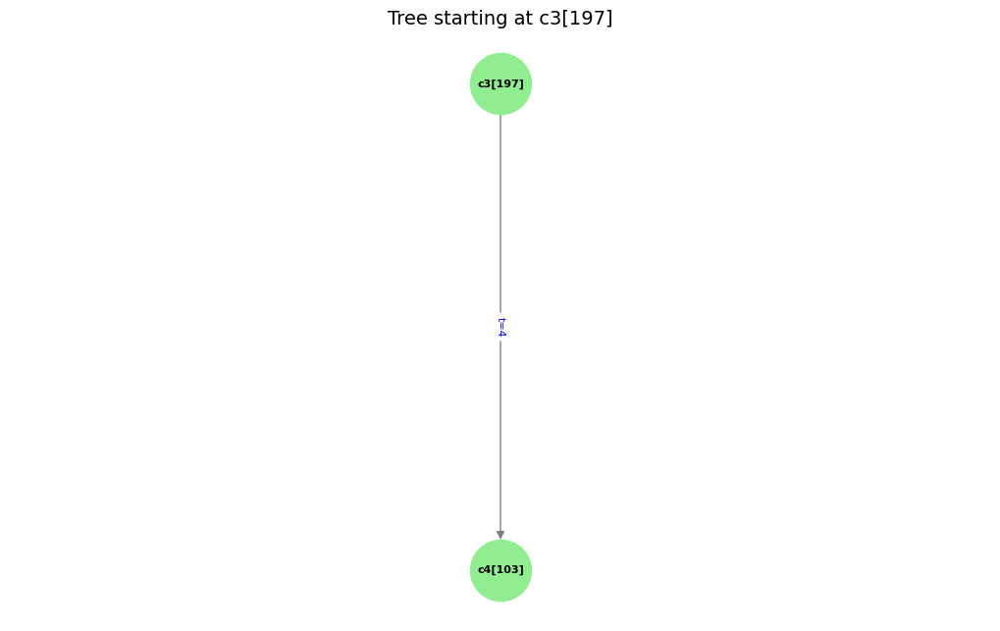

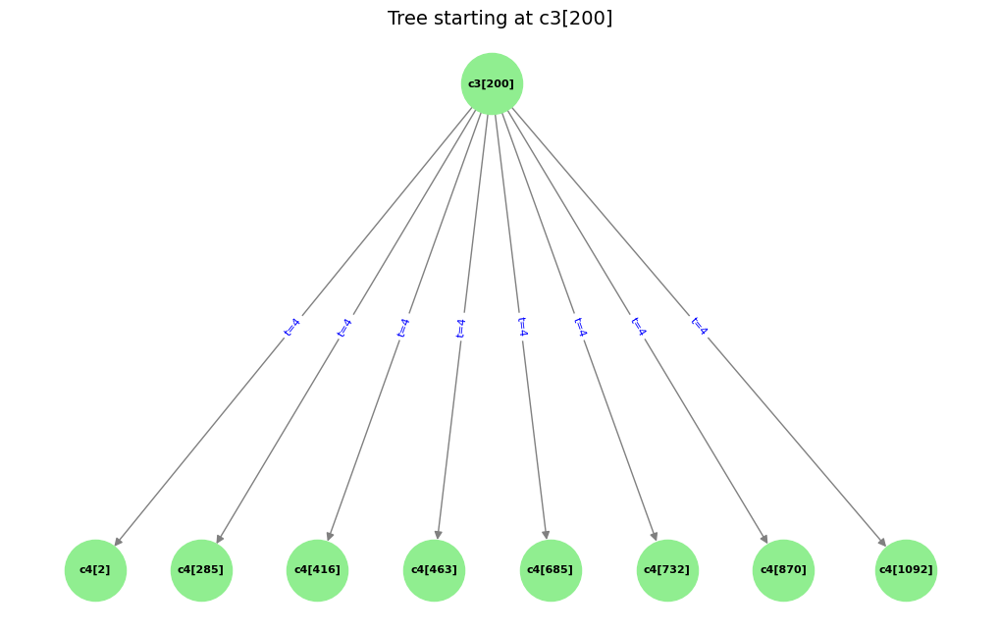

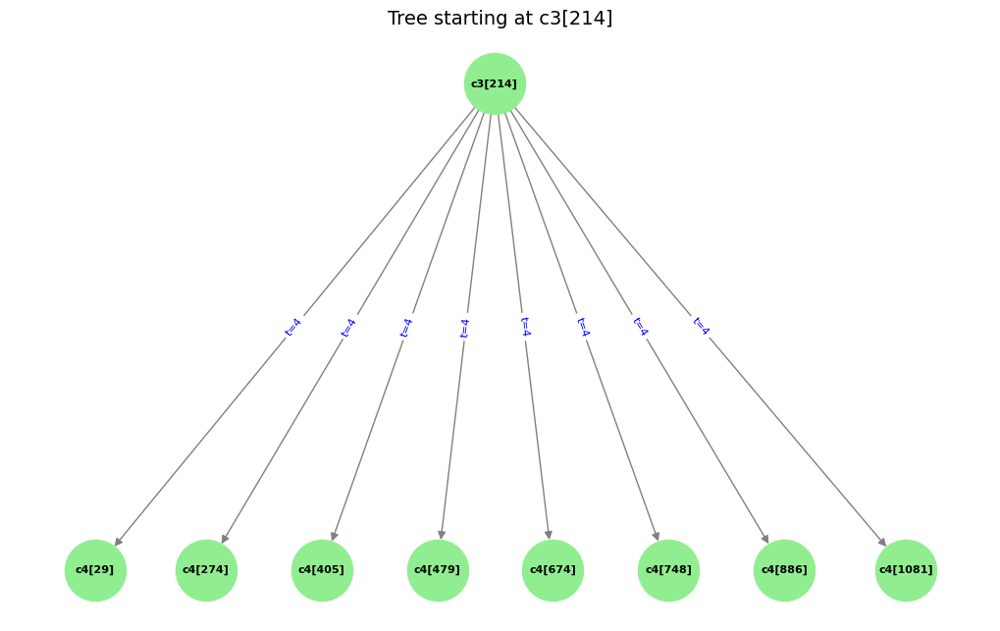

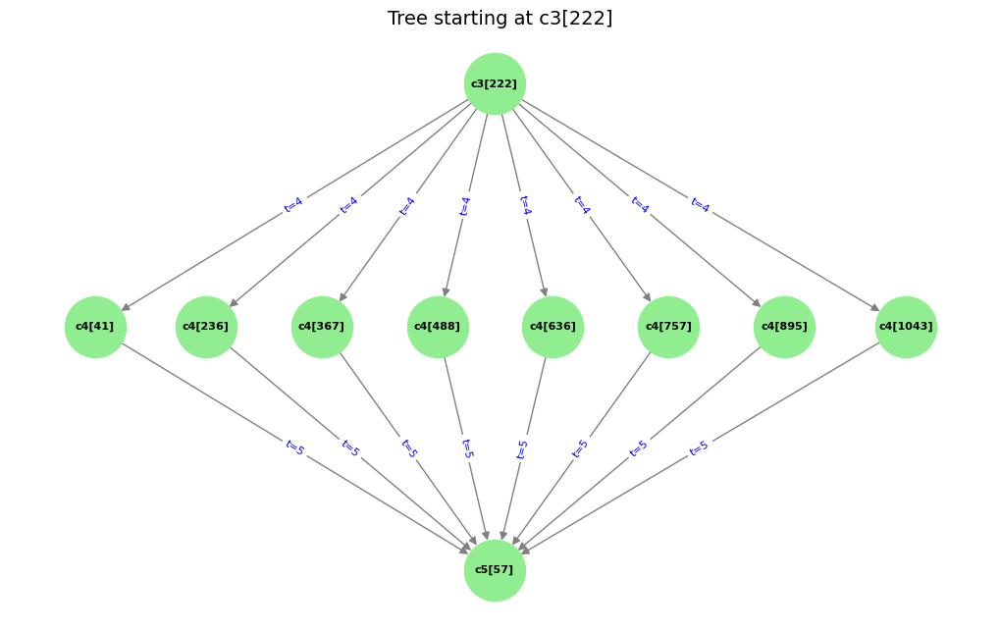

...

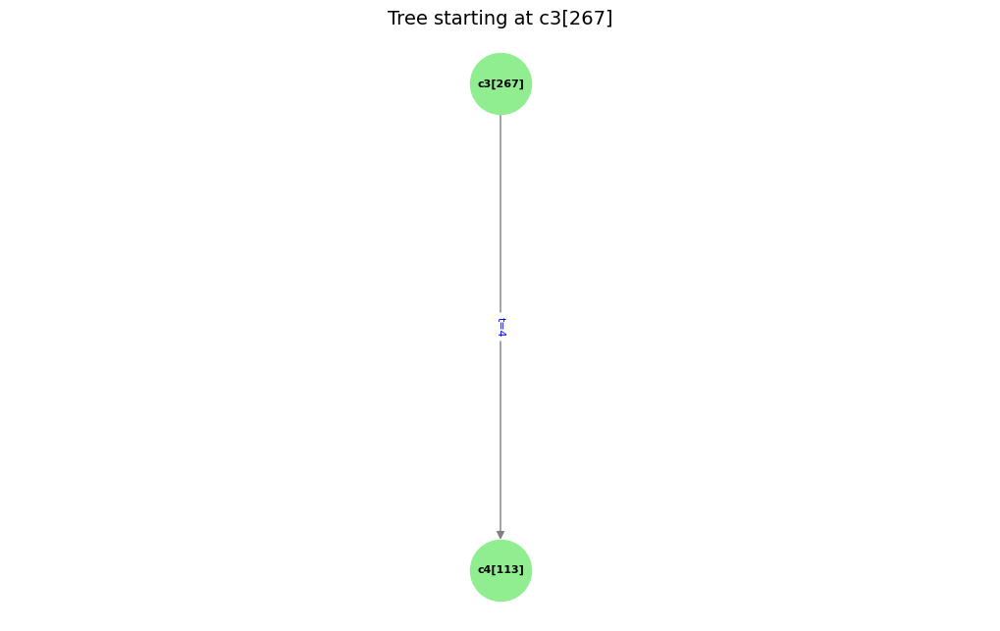

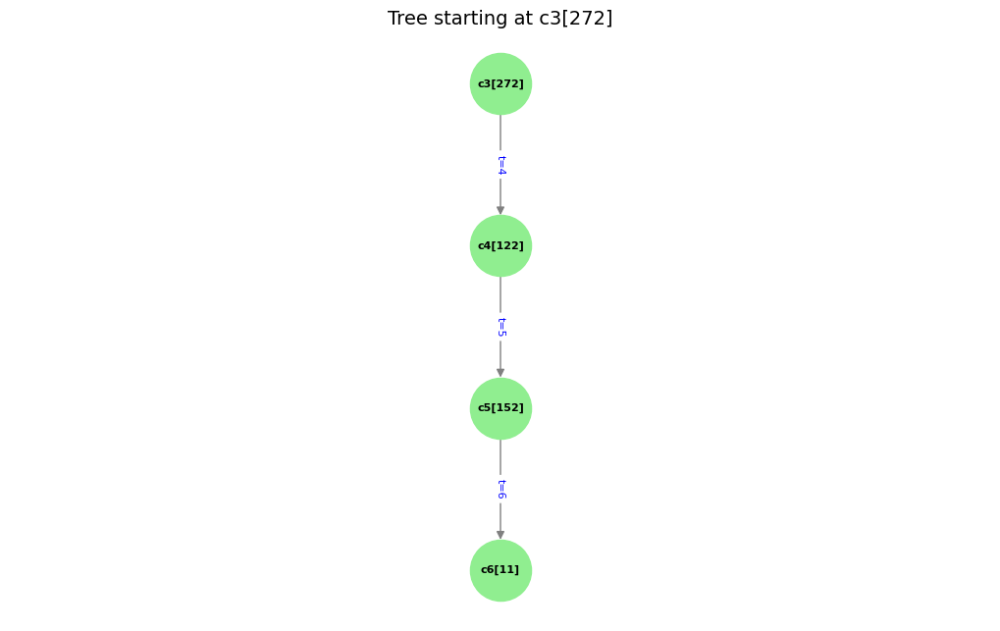

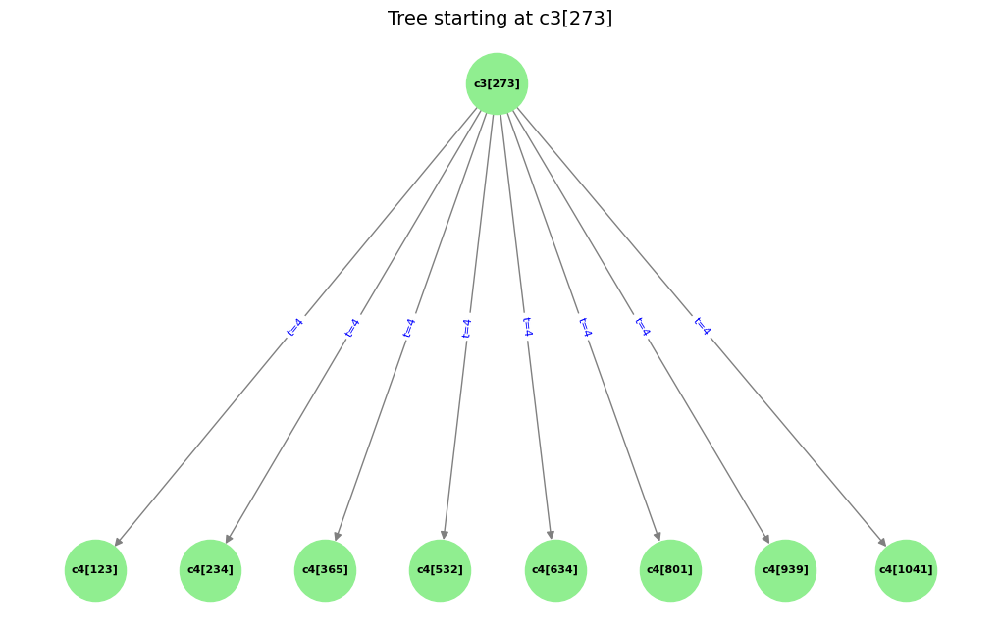

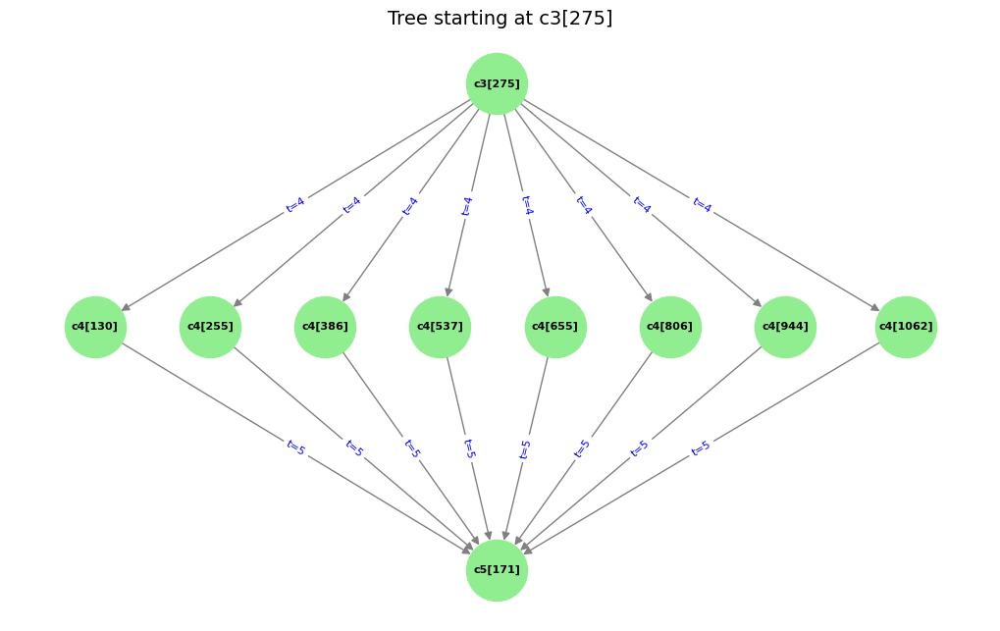

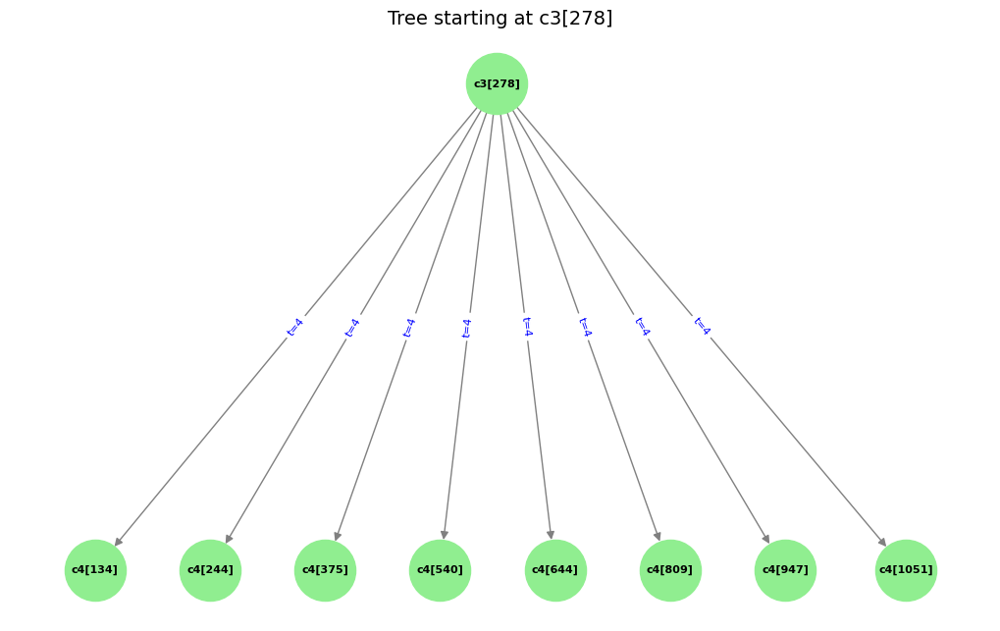

In [33]:
# import json
# import matplotlib.pyplot as plt
# import networkx as nx
# from collections import defaultdict

# # -------- Step 0. Load JSON file --------
# with open("overlap_results.json", "r") as f:
#     overlap_results = json.load(f)

# # -------- Step 1. Build tree dict from overlap_results --------
# tree_dict = defaultdict(list)

# for a, idx_a, matches in overlap_results:
#     parent = f"{a}[{idx_a}]"
#     for m in matches:
#         child = f"{m[0]}[{m[1]}]"
#         tree_dict[parent].append(child)

# # -------- Step 2. Recursive function to collect descendants --------
# def build_subtree(root, tree_dict, visited=None):
#     if visited is None:
#         visited = set()
#     visited.add(root)
#     subtree = nx.DiGraph()
#     children = tree_dict.get(root, [])
#     for child in children:
#         subtree.add_edge(root, child)
#         if child not in visited:
#             subtree = nx.compose(subtree, build_subtree(child, tree_dict, visited))
#     return subtree

# # -------- Step 3. Plot first 10 trees using Graphviz --------
# from networkx.drawing.nx_agraph import graphviz_layout

# def extract_timestamp(node_label):
#     # "c3[82]" -> "c3" -> 3
#     return int(node_label.split("[")[0].replace("c", ""))

# for i, (a, idx_a, _) in enumerate(overlap_results[41:61]):  # first 10 trees
#     root = f"{a}[{idx_a}]"
#     subtree = build_subtree(root, tree_dict)

#     plt.figure(figsize=(10, 6))
#     try:
#         # Organize nodes by timestamp using "dot" (top-to-bottom)
#         pos = graphviz_layout(subtree, prog="dot")

#         # Optional: manually adjust y-coordinates by timestamp
#         # so all same-timestamp nodes align horizontally
#         levels = {}
#         for node in subtree.nodes:
#             t = extract_timestamp(node)
#             if t not in levels:
#                 levels[t] = []
#             levels[t].append(node)

#         # overwrite pos y by timestamp
#         for t, nodes in levels.items():
#             for j, node in enumerate(nodes):
#                 pos[node] = (j, -t)  # x=j, y=-timestamp (so larger t goes lower)

#     except Exception as e:
#         print("Graphviz not available, using spring layout:", e)
#         pos = nx.spring_layout(subtree, seed=42)

#     nx.draw(
#         subtree, pos,
#         with_labels=True,
#         node_size=2000,
#         node_color="lightgreen",
#         font_size=8,
#         font_weight="bold",
#         edge_color="gray",
#         arrows=True,
#         arrowsize=12
#     )
#     plt.title(f"Tree starting at {root}", fontsize=14)
#     plt.show()

import json
import matplotlib.pyplot as plt
import networkx as nx
from collections import defaultdict

# -------- Step 0. Load JSON file --------
with open("overlap_results.json", "r") as f:
    overlap_results = json.load(f)

# -------- Step 1. Build tree dict from overlap_results --------
tree_dict = defaultdict(list)

for a, idx_a, matches in overlap_results:
    parent = f"{a}[{idx_a}]"
    for m in matches:
        child = f"{m[0]}[{m[1]}]"
        tree_dict[parent].append(child)

# -------- Step 2. Recursive function to collect descendants --------
def build_subtree(root, tree_dict, visited=None):
    if visited is None:
        visited = set()
    visited.add(root)
    subtree = nx.DiGraph()
    children = tree_dict.get(root, [])
    for child in children:
        subtree.add_edge(root, child)
        if child not in visited:
            subtree = nx.compose(subtree, build_subtree(child, tree_dict, visited))
    return subtree

# -------- Step 3. Add timestamp extractor --------
def extract_timestamp(node_label):
    # "c3[82]" -> "c3" -> 3
    return int(node_label.split("[")[0].replace("c", ""))

# -------- Step 4. Plot trees with timestamp edge labels --------
from networkx.drawing.nx_agraph import graphviz_layout

for i, (a, idx_a, _) in enumerate(overlap_results[41:61]):  # choose some trees
    root = f"{a}[{idx_a}]"
    subtree = build_subtree(root, tree_dict)

    plt.figure(figsize=(10, 6))
    try:
        # Use hierarchical layout
        pos = graphviz_layout(subtree, prog="dot")
    except Exception as e:
        print("Graphviz not available, using spring layout:", e)
        pos = nx.spring_layout(subtree, seed=42)

    # Draw the tree
    node_sizes = [300 + 50 * len(n) for n in subtree.nodes()]
    # --- Draw nodes + edges (no labels here) ---
    nx.draw(
        subtree, pos,
        with_labels=False,   # disable auto-labels
        node_size=2000,
        node_color="lightgreen",
        edge_color="gray",
        arrows=True,
        arrowsize=12
    )

    # --- Prepare shortened labels ---
    def shorten_label(label, maxlen=12):
        return label if len(label) <= maxlen else label[:maxlen] + "..."

    labels = {n: shorten_label(n) for n in subtree.nodes()}

    # --- Draw shortened labels ---
    nx.draw_networkx_labels(
        subtree, pos,
        labels=labels,
        font_size=8,
        font_weight="bold"
    )



    # --- Add timestamp labels beside edges ---
    edge_labels = {}
    for u, v in subtree.edges():
        ts = extract_timestamp(v)  # timestamp from child node
        edge_labels[(u, v)] = f"t={ts}"

    nx.draw_networkx_edge_labels(
        subtree, pos,
        edge_labels=edge_labels,
        font_size=8,
        font_color="blue"
    )

    plt.title(f"Tree starting at {root}", fontsize=14)
    plt.show()


In [5]:
import json
import matplotlib.pyplot as plt
import networkx as nx
from collections import defaultdict

# -------- Step 0. Load JSON file --------
with open("overlap_results.json", "r") as f:
    overlap_results = json.load(f)

# -------- Step 1. Build tree dict from overlap_results --------
tree_dict = defaultdict(list)

for a, idx_a, matches in overlap_results:
    parent = f"{a}[{idx_a}]"
    for m in matches:
        child = f"{m[0]}[{m[1]}]"
        tree_dict[parent].append(child)

# -------- Step 2. Recursive function to collect descendants --------
def build_subtree(root, tree_dict, visited=None):
    if visited is None:
        visited = set()
    visited.add(root)
    subtree = nx.DiGraph()
    children = tree_dict.get(root, [])
    for child in children:
        subtree.add_edge(root, child)
        if child not in visited:
            subtree = nx.compose(subtree, build_subtree(child, tree_dict, visited))
    return subtree

# -------- Step 3. Function to check if a root reaches c6 --------
def reaches_c6(root, tree_dict, visited=None):
    if visited is None:
        visited = set()
    if root.startswith("c6["):
        return True
    if root in visited:
        return False
    visited.add(root)
    for child in tree_dict.get(root, []):
        if reaches_c6(child, tree_dict, visited):
            return True
    return False

# -------- Step 4. Find candidate roots (from c3 only) --------
c3_roots = [f"{a}[{idx_a}]" for a, idx_a, _ in overlap_results if a == "c3"]
valid_roots = [r for r in c3_roots if reaches_c6(r, tree_dict)]

print(f"Found {len(valid_roots)} trees going from c3 to c6")

# -------- Step 5. Plot the first such tree --------
if valid_roots:
    root = valid_roots[0]
    subtree = build_subtree(root, tree_dict)

    plt.figure(figsize=(12, 7))
    pos = nx.multipartite_layout(subtree)  # aligns by layer c3->c4->c5->c6
    nx.draw(
        subtree, pos,
        with_labels=True,
        node_size=2200,
        node_color="lightgreen",
        font_size=8,
        font_weight="bold",
        edge_color="gray",
        arrows=True,
        arrowsize=12
    )
    plt.title(f"Tree from {root} down to c6", fontsize=14)
    plt.show()


Found 0 trees going from c3 to c6
